<a href="https://colab.research.google.com/github/maryembenghouma/Freelance-Project/blob/main/Data_preparation_%26%26_faisability_Image_version2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

Importation Des Bibliothéques

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

import tensorflow as tf
from tensorflow.keras.applications.vgg16 import VGG16
from tensorflow.keras.models import Model, Sequential

#biblio pour les images
from PIL import Image

import os

import nltk
from nltk.stem import WordNetLemmatizer
from nltk.corpus import stopwords, wordnet

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
!ls "/content/drive/MyDrive/Flipkart"


flipkart_com-ecommerce_sample_1050.csv	Images


In [ ]:
# loads and displays our summary statistics of our data
data = pd.read_table("/content/drive/MyDrive/Flipkart/flipkart_com-ecommerce_sample_1050.csv",sep=",", header=0)

In [ ]:
data.shape

(1050, 15)

In [ ]:
print('Flipkart dataset containes ',data.shape[0],' rows and',data.shape[1],'columns.')

Flipkart dataset containes  1050  rows and 15 columns.


In [ ]:
data.columns

Index(['uniq_id', 'crawl_timestamp', 'product_url', 'product_name',
       'product_category_tree', 'pid', 'retail_price', 'discounted_price',
       'image', 'is_FK_Advantage_product', 'description', 'product_rating',
       'overall_rating', 'brand', 'product_specifications'],
      dtype='object')

In [ ]:
data.head()

,uniq_id,crawl_timestamp,product_url,product_name,product_category_tree,pid,retail_price,discounted_price,image,is_FK_Advantage_product,description,product_rating,overall_rating,brand,product_specifications
0,55b85ea15a1536d46b7190ad6fff8ce7,2016-04-30 03:22:56 +0000,http://www.flipkart.com/elegance-polyester-mul...,Elegance Polyester Multicolor Abstract Eyelet ...,"[""Home Furnishing >> Curtains & Accessories >>...",CRNEG7BKMFFYHQ8Z,1899.0,899.0,55b85ea15a1536d46b7190ad6fff8ce7.jpg,False,Key Features of Elegance Polyester Multicolor ...,No rating available,No rating available,Elegance,"{""product_specification""=>[{""key""=>""Brand"", ""v..."
1,7b72c92c2f6c40268628ec5f14c6d590,2016-04-30 03:22:56 +0000,http://www.flipkart.com/sathiyas-cotton-bath-t...,Sathiyas Cotton Bath Towel,"[""Baby Care >> Baby Bath & Skin >> Baby Bath T...",BTWEGFZHGBXPHZUH,600.0,449.0,7b72c92c2f6c40268628ec5f14c6d590.jpg,False,Specifications of Sathiyas Cotton Bath Towel (...,No rating available,No rating available,Sathiyas,"{""product_specification""=>[{""key""=>""Machine Wa..."
2,64d5d4a258243731dc7bbb1eef49ad74,2016-04-30 03:22:56 +0000,http://www.flipkart.com/eurospa-cotton-terry-f...,Eurospa Cotton Terry Face Towel Set,"[""Baby Care >> Baby Bath & Skin >> Baby Bath T...",BTWEG6SHXTDB2A2Y,NaN,NaN,64d5d4a258243731dc7bbb1eef49ad74.jpg,False,Key Features of Eurospa Cotton Terry Face Towe...,No rating available,No rating available,Eurospa,"{""product_specification""=>[{""key""=>""Material"",..."
3,d4684dcdc759dd9cdf41504698d737d8,2016-06-20 08:49:52 +0000,http://www.flipkart.com/santosh-royal-fashion-...,SANTOSH ROYAL FASHION Cotton Printed King size...,"[""Home Furnishing >> Bed Linen >> Bedsheets >>...",BDSEJT9UQWHDUBH4,2699.0,1299.0,d4684dcdc759dd9cdf41504698d737d8.jpg,False,Key Features of SANTOSH ROYAL FASHION Cotton P...,No rating available,No rating available,SANTOSH ROYAL FASHION,"{""product_specification""=>[{""key""=>""Brand"", ""v..."
4,6325b6870c54cd47be6ebfbffa620ec7,2016-06-20 08:49:52 +0000,http://www.flipkart.com/jaipur-print-cotton-fl...,Jaipur Print Cotton Floral King sized Double B...,"[""Home Furnishing >> Bed Linen >> Bedsheets >>...",BDSEJTHNGWVGWWQU,2599.0,698.0,6325b6870c54cd47be6ebfbffa620ec7.jpg,False,Key Features of Jaipur Print Cotton Floral Kin...,No rating available,No rating available,Jaipur Print,"{""product_specification""=>[{""key""=>""Machine Wa..."


In [ ]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1050 entries, 0 to 1049
Data columns (total 15 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   uniq_id                  1050 non-null   object 
 1   crawl_timestamp          1050 non-null   object 
 2   product_url              1050 non-null   object 
 3   product_name             1050 non-null   object 
 4   product_category_tree    1050 non-null   object 
 5   pid                      1050 non-null   object 
 6   retail_price             1049 non-null   float64
 7   discounted_price         1049 non-null   float64
 8   image                    1050 non-null   object 
 9   is_FK_Advantage_product  1050 non-null   bool   
 10  description              1050 non-null   object 
 11  product_rating           1050 non-null   object 
 12  overall_rating           1050 non-null   object 
 13  brand                    712 non-null    object 
 14  product_specifications  

In [ ]:
# Vérifier s'il y a des valeurs manquantes dans toute la data
missing_values = data.isnull().sum()
print("Valeurs manquantes dans chaque colonne :\n", missing_values)


Valeurs manquantes dans chaque colonne :
 uniq_id                      0
crawl_timestamp              0
product_url                  0
product_name                 0
product_category_tree        0
pid                          0
retail_price                 1
discounted_price             1
image                        0
is_FK_Advantage_product      0
description                  0
product_rating               0
overall_rating               0
brand                      338
product_specifications       1
dtype: int64


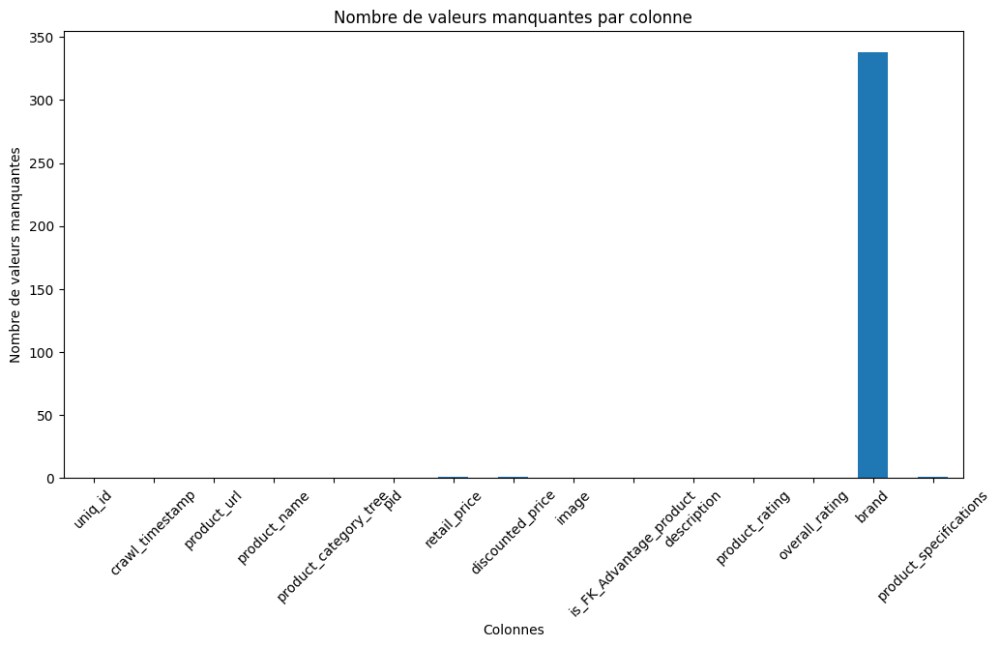

In [ ]:
import matplotlib.pyplot as plt

# Calculer le nombre de valeurs manquantes dans chaque colonne
missing_values = data.isnull().sum()

# Créer un graphique
plt.figure(figsize=(12, 6))
missing_values.plot(kind='bar')
plt.title('Nombre de valeurs manquantes par colonne')
plt.xlabel('Colonnes')
plt.ylabel('Nombre de valeurs manquantes')
plt.xticks(rotation=45)
plt.show()


In [ ]:
most_frequent_brand = data['brand'].value_counts().idxmax()
print("La marque la plus fréquente est :", most_frequent_brand)


La marque la plus fréquente est : PRINT SHAPES


In [ ]:
# remplir les colonnes vides par la brand la plus fréquente
data['brand'] = data['brand'].fillna(most_frequent_brand)


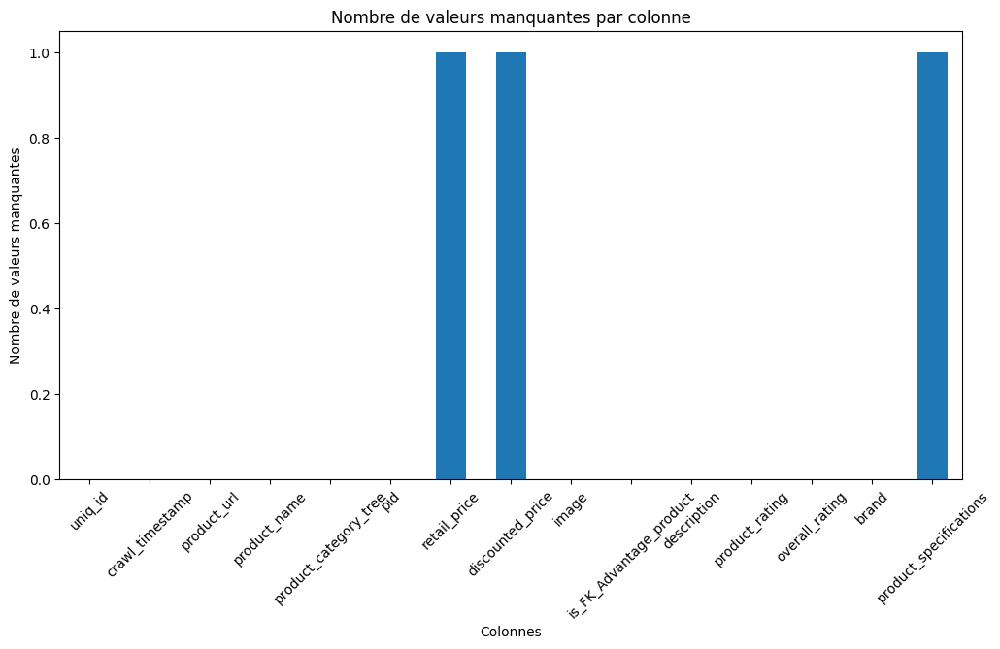

In [ ]:
#vérifiant maintenat si on a encore des valeurs manquantes
import matplotlib.pyplot as plt

# Calculer le nombre de valeurs manquantes dans chaque colonne
missing_values = data.isnull().sum()

# Créer un graphique
plt.figure(figsize=(12, 6))
missing_values.plot(kind='bar')
plt.title('Nombre de valeurs manquantes par colonne')
plt.xlabel('Colonnes')
plt.ylabel('Nombre de valeurs manquantes')
plt.xticks(rotation=45)
plt.show()


In [ ]:
# Imputation pour 'discounted_price' et 'retail_price'
data['discounted_price'].fillna(data['discounted_price'].median(), inplace=True)
data['retail_price'].fillna(data['retail_price'].median(), inplace=True)

# Imputation pour 'product_specifications'
most_frequent_spec = data['product_specifications'].mode()[0]
data['product_specifications'].fillna(most_frequent_spec, inplace=True)


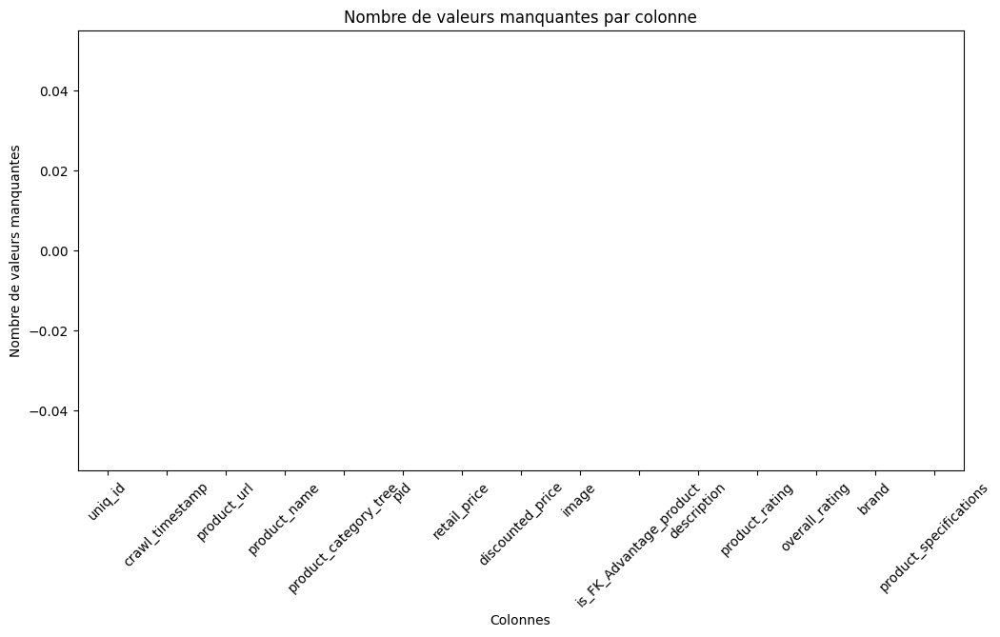

In [ ]:
#vérifiant s'il ya encore des valeurs manquantes

import matplotlib.pyplot as plt

# Calculer le nombre de valeurs manquantes dans chaque colonne
missing_values = data.isnull().sum()

# Créer un graphique
plt.figure(figsize=(12, 6))
missing_values.plot(kind='bar')
plt.title('Nombre de valeurs manquantes par colonne')
plt.xlabel('Colonnes')
plt.ylabel('Nombre de valeurs manquantes')
plt.xticks(rotation=45)
plt.show()


In [ ]:
data.duplicated().sum()

0

charger les images a partir du dossier et les mettre selon le nom de chaque image  donner dans la colonne image

In [ ]:
data.iloc[0].product_category_tree

'["Home Furnishing >> Curtains & Accessories >> Curtains >> Elegance Polyester Multicolor Abstract Eyelet Do..."]'

In [ ]:
data['category'] = data['product_category_tree'].apply(lambda x : x.split('>>')[0].strip('[]" '))

In [ ]:
data['subcategory'] = data['product_category_tree'].apply(lambda x : x.split('>>')[1].strip('[]" '))

In [ ]:
data['product'] = data['product_category_tree'].apply(lambda x: x.split('>>')[2].strip('[]" ') if len(x.split('>>')) > 2 else None)

In [ ]:
data.category.value_counts()

category
Home Furnishing               150
Baby Care                     150
Watches                       150
Home Decor & Festive Needs    150
Kitchen & Dining              150
Beauty and Personal Care      150
Computers                     150
Name: count, dtype: int64

<Axes: ylabel='category'>

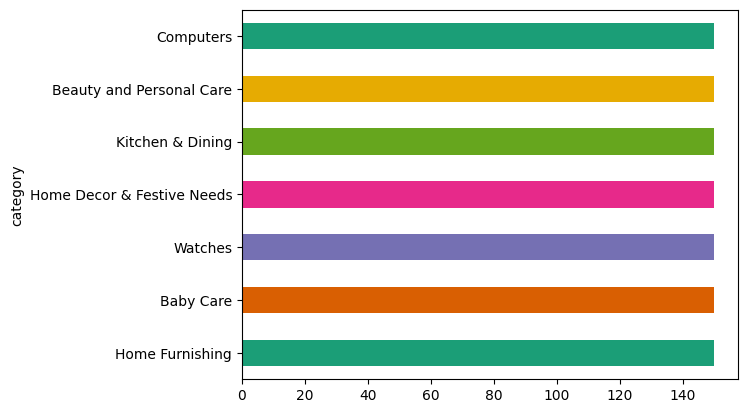

In [ ]:
data.category.value_counts().plot(kind='barh', color=sns.palettes.mpl_palette('Dark2'))

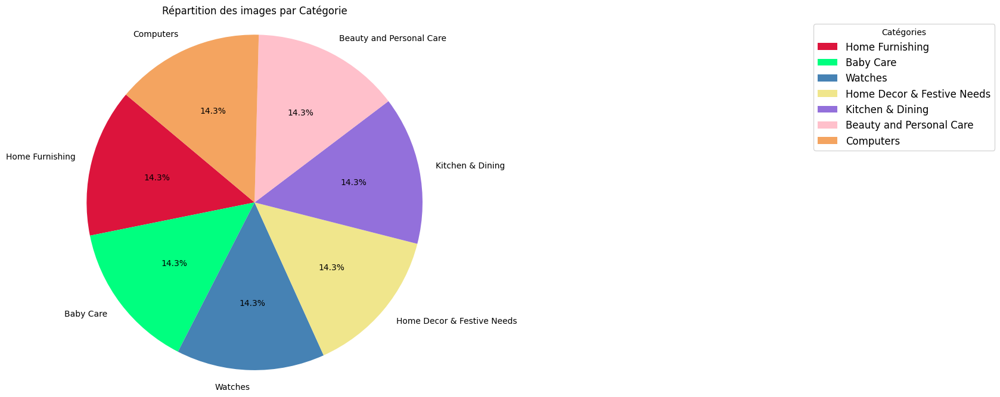

In [ ]:
import matplotlib.pyplot as plt

# Calculer les valeurs et les étiquettes pour le pie plot
categories = data['category'].value_counts().index
sizes = data['category'].value_counts().values

# Définir les couleurs pour chaque tranche de pie plot
colors = ['Crimson', 'SpringGreen', 'SteelBlue', 'Khaki', 'MediumPurple', 'pink', 'SandyBrown']

# Tracer le pie plot
plt.figure(figsize=(8, 8))
plt.pie(sizes, labels=categories, colors=colors, autopct='%1.1f%%', startangle=140)
plt.title('Répartition des images par Catégorie')
plt.axis('equal')  # Assurez-vous que le pie plot est parfaitement circulaire

# Ajouter une légende
plt.legend(loc="upper left", fontsize=12, title="Catégories", bbox_to_anchor=(2, 1))
plt.show()


==> Répartition équilibrée de 150 images par catégorie.

In [ ]:
data.shape

(1050, 18)

In [ ]:
data.head()

,uniq_id,crawl_timestamp,product_url,product_name,product_category_tree,pid,retail_price,discounted_price,image,is_FK_Advantage_product,description,product_rating,overall_rating,brand,product_specifications,category,subcategory,product
0,55b85ea15a1536d46b7190ad6fff8ce7,2016-04-30 03:22:56 +0000,http://www.flipkart.com/elegance-polyester-mul...,Elegance Polyester Multicolor Abstract Eyelet ...,"[""Home Furnishing >> Curtains & Accessories >>...",CRNEG7BKMFFYHQ8Z,1899.0,899.0,55b85ea15a1536d46b7190ad6fff8ce7.jpg,False,Key Features of Elegance Polyester Multicolor ...,No rating available,No rating available,Elegance,"{""product_specification""=>[{""key""=>""Brand"", ""v...",Home Furnishing,Curtains & Accessories,Curtains
1,7b72c92c2f6c40268628ec5f14c6d590,2016-04-30 03:22:56 +0000,http://www.flipkart.com/sathiyas-cotton-bath-t...,Sathiyas Cotton Bath Towel,"[""Baby Care >> Baby Bath & Skin >> Baby Bath T...",BTWEGFZHGBXPHZUH,600.0,449.0,7b72c92c2f6c40268628ec5f14c6d590.jpg,False,Specifications of Sathiyas Cotton Bath Towel (...,No rating available,No rating available,Sathiyas,"{""product_specification""=>[{""key""=>""Machine Wa...",Baby Care,Baby Bath & Skin,Baby Bath Towels
2,64d5d4a258243731dc7bbb1eef49ad74,2016-04-30 03:22:56 +0000,http://www.flipkart.com/eurospa-cotton-terry-f...,Eurospa Cotton Terry Face Towel Set,"[""Baby Care >> Baby Bath & Skin >> Baby Bath T...",BTWEG6SHXTDB2A2Y,999.0,600.0,64d5d4a258243731dc7bbb1eef49ad74.jpg,False,Key Features of Eurospa Cotton Terry Face Towe...,No rating available,No rating available,Eurospa,"{""product_specification""=>[{""key""=>""Material"",...",Baby Care,Baby Bath & Skin,Baby Bath Towels
3,d4684dcdc759dd9cdf41504698d737d8,2016-06-20 08:49:52 +0000,http://www.flipkart.com/santosh-royal-fashion-...,SANTOSH ROYAL FASHION Cotton Printed King size...,"[""Home Furnishing >> Bed Linen >> Bedsheets >>...",BDSEJT9UQWHDUBH4,2699.0,1299.0,d4684dcdc759dd9cdf41504698d737d8.jpg,False,Key Features of SANTOSH ROYAL FASHION Cotton P...,No rating available,No rating available,SANTOSH ROYAL FASHION,"{""product_specification""=>[{""key""=>""Brand"", ""v...",Home Furnishing,Bed Linen,Bedsheets
4,6325b6870c54cd47be6ebfbffa620ec7,2016-06-20 08:49:52 +0000,http://www.flipkart.com/jaipur-print-cotton-fl...,Jaipur Print Cotton Floral King sized Double B...,"[""Home Furnishing >> Bed Linen >> Bedsheets >>...",BDSEJTHNGWVGWWQU,2599.0,698.0,6325b6870c54cd47be6ebfbffa620ec7.jpg,False,Key Features of Jaipur Print Cotton Floral Kin...,No rating available,No rating available,Jaipur Print,"{""product_specification""=>[{""key""=>""Machine Wa...",Home Furnishing,Bed Linen,Bedsheets


IMAGES

In [ ]:
!ls "/content/drive/MyDrive/Flipkart/Images"

009099b1f6e1e8f893ec29a7023153c4.jpg  7ec5ac2dea80b6c5e4cfd20eba597d20.jpg
0096e89cc25a8b96fb9808716406fe94.jpg  7ee2e665b7de2e1cc29e3c65bde0c318.jpg
00cbbc837d340fa163d11e169fbdb952.jpg  7f2f1f3039d1f5bc23226fc36577eab9.jpg
00d84a518e0550612fcfcba3b02b6255.jpg  7f6678a6217c831b716feca796f689fd.jpg
00e966a5049a262cfc72e6bbf68b80e7.jpg  7f7c64d439d64656d6baa40f5798cdf5.jpg
00ed03657cedbe4663eff2d7fa702a33.jpg  7fd12776e6d62da6e1dd3cbc9882ee5f.jpg
01089dc3618a0ab7304d784ef400b83d.jpg  7fd3f7b35e8b4a66432c974c8cb5c46d.jpg
0131e5d87b72877702d536299cf83b75.jpg  8015db34d09642b046c775e8157dd729.jpg
020d2daba55a723128e4e07c0b0393a9.jpg  8026dc3e27e8e318cc7431a723f7ebc1.jpg
02127f52e96fb72c66bf081d25104ef8.jpg  8050d31bffe6827c804b8222338aafb2.jpg
025a85a3d1cddc6307f7dc075d8d2132.jpg  80e9cb3d2d7f9ff7bc497c34df366d03.jpg
02a53d335775b652f22f41b529b9d646.jpg  812bfd40e47dfde2ff5326e899b42577.jpg
02c63a087b298ec74042d557acf61be1.jpg  8141b9d5af35017a907b1e88c17f7963.jpg
031c98cfde349d99fb6d5983f

In [ ]:
data_im = data[['image', 'category']].copy()

In [ ]:
# Ajout de la colonne 'image_path' contenant les chemins d'accès complets des images
path = '/content/drive/MyDrive/Flipkart/Images/'  # Chemin d'accès de base
data_im['image_path'] = path + data_im['image']


In [ ]:
# Affichage des cinq premières lignes du DataFrame pour vérification
data_im.head()

,image,category,image_path
0,55b85ea15a1536d46b7190ad6fff8ce7.jpg,Home Furnishing,/content/drive/MyDrive/Flipkart/Images/55b85ea...
1,7b72c92c2f6c40268628ec5f14c6d590.jpg,Baby Care,/content/drive/MyDrive/Flipkart/Images/7b72c92...
2,64d5d4a258243731dc7bbb1eef49ad74.jpg,Baby Care,/content/drive/MyDrive/Flipkart/Images/64d5d4a...
3,d4684dcdc759dd9cdf41504698d737d8.jpg,Home Furnishing,/content/drive/MyDrive/Flipkart/Images/d4684dc...
4,6325b6870c54cd47be6ebfbffa620ec7.jpg,Home Furnishing,/content/drive/MyDrive/Flipkart/Images/6325b68...


In [ ]:
data_im['category'][0]

'Home Furnishing'

chargement des Images pour vérifier si les paths crée correcte

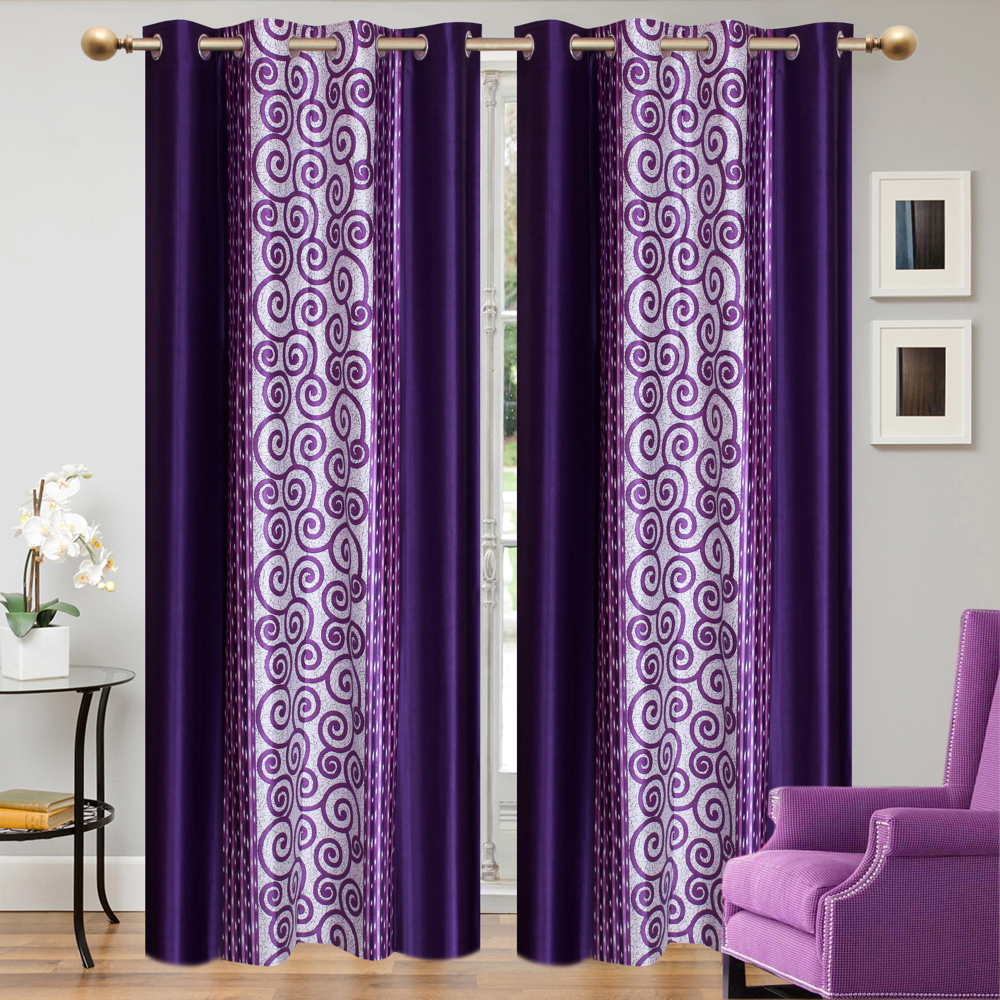

In [ ]:
from PIL import Image

Image.open(data_im.iloc[0]['image_path'])

In [ ]:
data_im['category'][12]

'Watches'

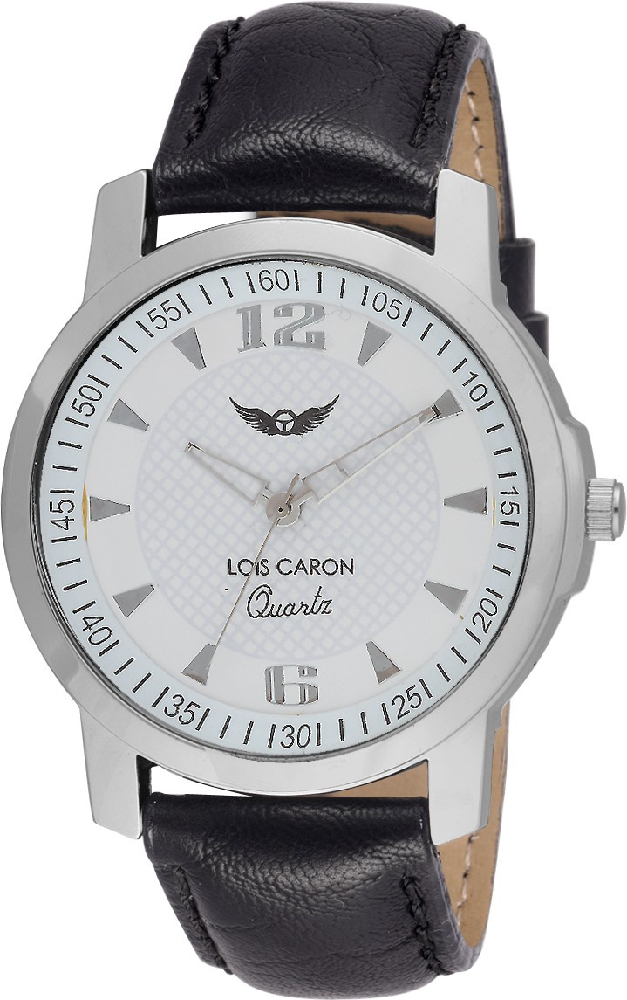

In [ ]:
Image.open(data_im.iloc[12]['image_path'])

Verification si les catégories sont bien associer au images

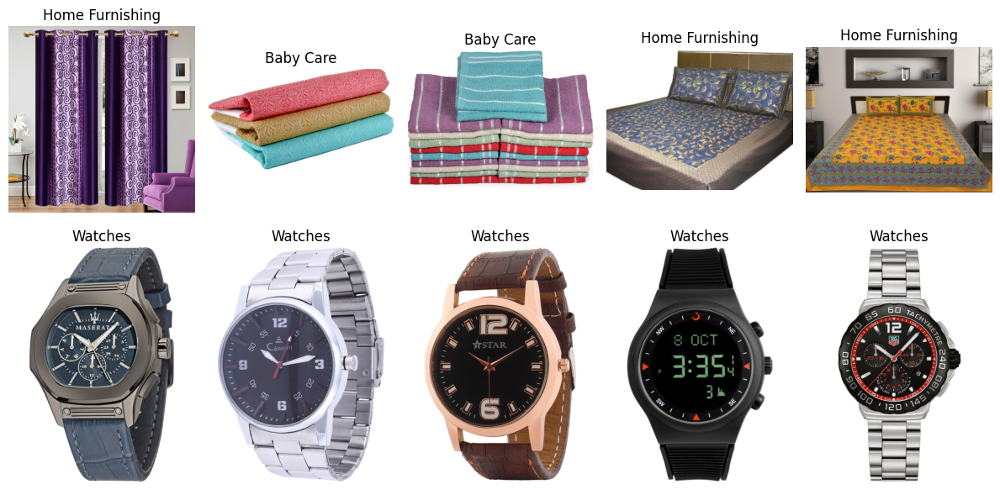

In [ ]:
fig, axes = plt.subplots(2, 5, figsize=(12, 6))
for i in range(10):
    ax = axes[i // 5, i % 5]
    img_path = data_im['image_path'].iloc[i]
    img = Image.open(img_path)
    ax.imshow(img, cmap="gray")
    ax.set_title(data_im['category'].iloc[i])
    ax.axis('off')

plt.tight_layout()
plt.show()

calcul de largeur des images

In [ ]:
import os

# Calcul des statistiques descriptives sur les dimensions des images (largeur)
largeurs_images = []

for row in data_im['image_path']:
    if os.path.exists(row):
        largeur_image = Image.open(row).size[0]
        largeurs_images.append(largeur_image)
    else:
        # Gérer le cas où le fichier image est introuvable
        largeurs_images.append(None)  # ou une autre valeur par défaut

data_im['Largeur_img'] = largeurs_images


/usr/local/lib/python3.10/dist-packages/PIL/Image.py:3167: DecompressionBombWarning: Image size (93680328 pixels) exceeds limit of 89478485 pixels, could be decompression bomb DOS attack.
  warnings.warn(


In [ ]:
import numpy as np

def stat_descriptives(data, columns):

    descriptive_stats = data[columns].describe()
    return descriptive_stats


In [ ]:
# Calcul des statistiques descriptives sur les dimensions des images (largeur)
print(stat_descriptives(data_im, ['Largeur_img']))


       Largeur_img
count  1049.000000
mean   1197.329838
std     864.138327
min     145.000000
25%     751.000000
50%    1100.000000
75%    1216.000000
max    8484.000000


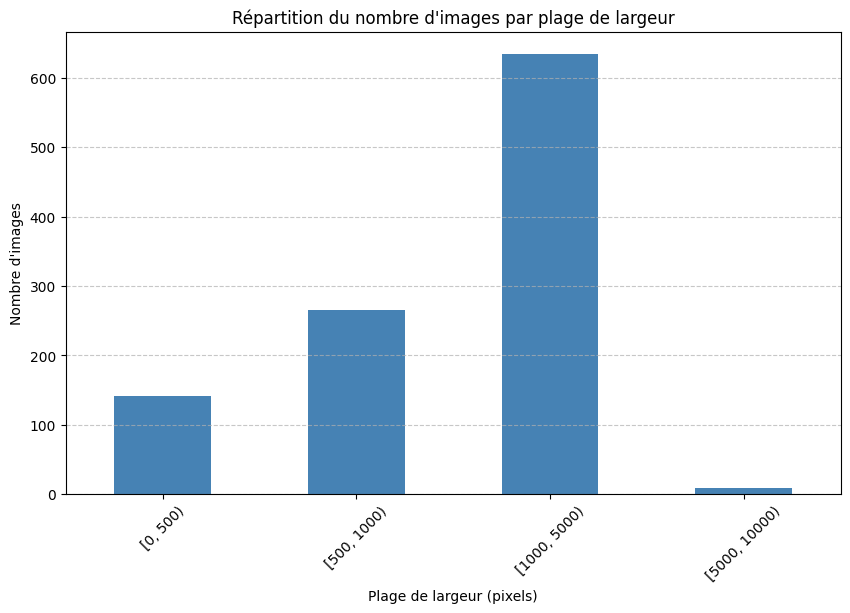

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt

# Définir les plages de largeur des images
plages_largeur = [0, 500, 1000, 5000, 10000]

# Créer une nouvelle colonne 'Plage_largeur' contenant la plage correspondante pour chaque largeur d'image
data_im['Plage_largeur'] = pd.cut(data_im['Largeur_img'], bins=plages_largeur, right=False)

# Calculer le nombre d'images dans chaque plage de largeur
nb_images_par_plage = data_im['Plage_largeur'].value_counts().sort_index()

# Tracer le diagramme en barres pour la répartition du nombre d'images par plage de largeur
plt.figure(figsize=(10, 6))
nb_images_par_plage.plot(kind='bar', color='steelblue')
plt.title('Répartition du nombre d\'images par plage de largeur')
plt.xlabel('Plage de largeur (pixels)')
plt.ylabel('Nombre d\'images')
plt.xticks(rotation=45)
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.show()


calcul des hauteurs des images

In [ ]:
# Calcul des hauteurs des images
hauteurs_images = []

for row in data_im['image_path']:
    if os.path.exists(row):
        hauteur_image = Image.open(row).size[1]
        hauteurs_images.append(hauteur_image)
    else:
        # Gérer le cas où le fichier image est introuvable
        hauteurs_images.append(None)  # ou une autre valeur par défaut

data_im['Hauteur_img'] = hauteurs_images

/usr/local/lib/python3.10/dist-packages/PIL/Image.py:3167: DecompressionBombWarning: Image size (93680328 pixels) exceeds limit of 89478485 pixels, could be decompression bomb DOS attack.
  warnings.warn(


In [ ]:
# Définir les plages de hauteur des images
plages_hauteur = [0, 500, 1000, 5000, 11100]

# Créer une nouvelle colonne 'Plage_hauteur' contenant la plage correspondante pour chaque hauteur d'image
data_im['Plage_hauteur'] = pd.cut(data_im['Hauteur_img'], bins=plages_hauteur, right=False)



In [ ]:
data_im

,image,category,image_path,Largeur_img,Hauteur_img,Plage_hauteur,Plage_largeur
0,55b85ea15a1536d46b7190ad6fff8ce7.jpg,Home Furnishing,/content/drive/MyDrive/Flipkart/Images/55b85ea...,3600.0,3600.0,"[1000, 5000)","[1000, 5000)"
1,7b72c92c2f6c40268628ec5f14c6d590.jpg,Baby Care,/content/drive/MyDrive/Flipkart/Images/7b72c92...,2388.0,1293.0,"[1000, 5000)","[1000, 5000)"
2,64d5d4a258243731dc7bbb1eef49ad74.jpg,Baby Care,/content/drive/MyDrive/Flipkart/Images/64d5d4a...,982.0,729.0,"[500, 1000)","[500, 1000)"
3,d4684dcdc759dd9cdf41504698d737d8.jpg,Home Furnishing,/content/drive/MyDrive/Flipkart/Images/d4684dc...,1100.0,831.0,"[500, 1000)","[1000, 5000)"
4,6325b6870c54cd47be6ebfbffa620ec7.jpg,Home Furnishing,/content/drive/MyDrive/Flipkart/Images/6325b68...,2670.0,2088.0,"[1000, 5000)","[1000, 5000)"
...,...,...,...,...,...,...,...
1045,958f54f4c46b53c8a0a9b8167d9140bc.jpg,Baby Care,/content/drive/MyDrive/Flipkart/Images/958f54f...,1100.0,937.0,"[500, 1000)","[1000, 5000)"
1046,fd6cbcc22efb6b761bd564c28928483c.jpg,Baby Care,/content/drive/MyDrive/Flipkart/Images/fd6cbcc...,900.0,1200.0,"[1000, 5000)","[500, 1000)"
1047,5912e037d12774bb73a2048f35a00009.jpg,Baby Care,/content/drive/MyDrive/Flipkart/Images/5912e03...,1100.0,1011.0,"[1000, 5000)","[1000, 5000)"
1048,c3edc504d1b4f0ba6224fa53a43a7ad6.jpg,Baby Care,/content/drive/MyDrive/Flipkart/Images/c3edc50...,900.0,1200.0,"[1000, 5000)","[500, 1000)"


In [ ]:
# Calculer le nombre d'images dans chaque plage de hauteur
nb_images_par_plage_hauteur = data_im['Plage_hauteur'].value_counts().sort_index()

# Afficher la répartition du nombre d'images par plage de hauteur
print(nb_images_par_plage_hauteur)

Plage_hauteur
[0, 500)          88
[500, 1000)      293
[1000, 5000)     666
[5000, 11100)      2
Name: count, dtype: int64


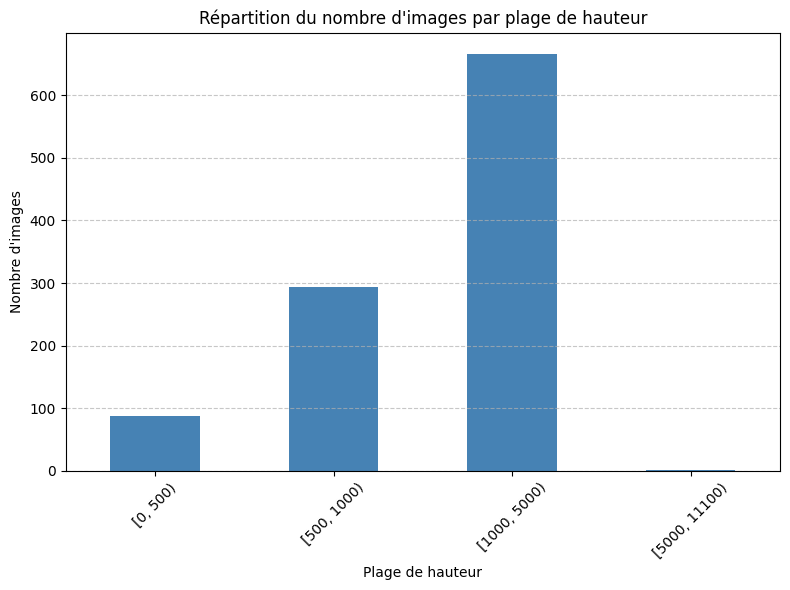

In [ ]:
import matplotlib.pyplot as plt

# Créer un histogramme pour visualiser la répartition du nombre d'images par plage de hauteur
plt.figure(figsize=(8, 6))
nb_images_par_plage_hauteur.plot(kind='bar', color='steelblue')
plt.title('Répartition du nombre d\'images par plage de hauteur')
plt.xlabel('Plage de hauteur')
plt.ylabel('Nombre d\'images')
plt.xticks(rotation=45)
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.tight_layout()
plt.show()


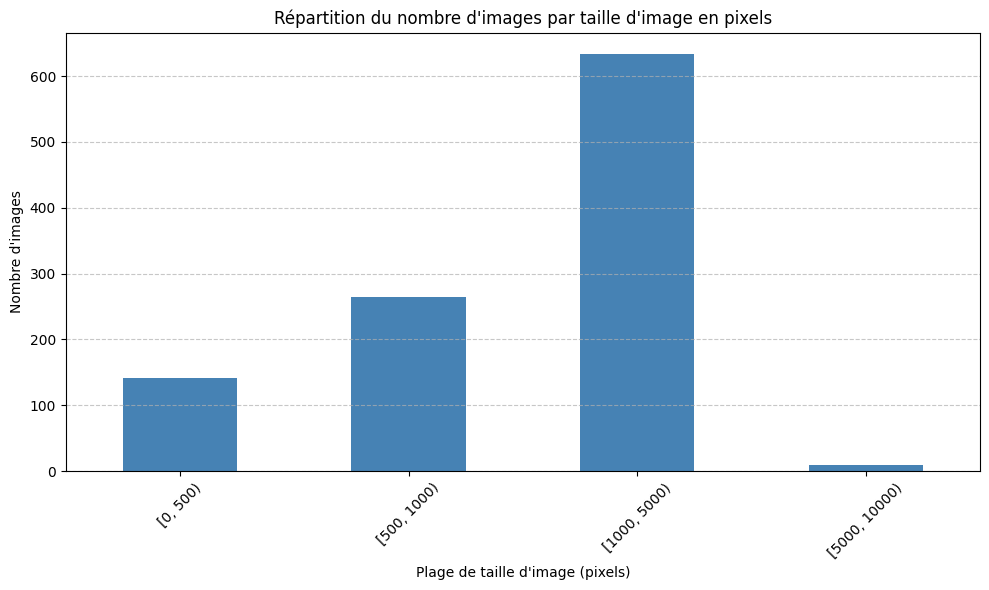

In [ ]:
# Calculer le nombre d'images dans chaque plage de taille d'image en pixels
nb_images_par_plage_taille = data_im['Plage_largeur'].value_counts().sort_index()

# Tracer le diagramme en barres pour la répartition du nombre d'images par taille d'image en pixels
plt.figure(figsize=(10, 6))
nb_images_par_plage_taille.plot(kind='bar', color='steelblue')
plt.title('Répartition du nombre d\'images par taille d\'image en pixels')
plt.xlabel('Plage de taille d\'image (pixels)')
plt.ylabel('Nombre d\'images')
plt.xticks(rotation=45)
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.tight_layout()
plt.show()


In [ ]:
data_im

,image,category,image_path,Largeur_img,Hauteur_img,Plage_hauteur,Plage_largeur
0,55b85ea15a1536d46b7190ad6fff8ce7.jpg,Home Furnishing,/content/drive/MyDrive/Flipkart/Images/55b85ea...,3600.0,3600.0,"[1000, 5000)","[1000, 5000)"
1,7b72c92c2f6c40268628ec5f14c6d590.jpg,Baby Care,/content/drive/MyDrive/Flipkart/Images/7b72c92...,2388.0,1293.0,"[1000, 5000)","[1000, 5000)"
2,64d5d4a258243731dc7bbb1eef49ad74.jpg,Baby Care,/content/drive/MyDrive/Flipkart/Images/64d5d4a...,982.0,729.0,"[500, 1000)","[500, 1000)"
3,d4684dcdc759dd9cdf41504698d737d8.jpg,Home Furnishing,/content/drive/MyDrive/Flipkart/Images/d4684dc...,1100.0,831.0,"[500, 1000)","[1000, 5000)"
4,6325b6870c54cd47be6ebfbffa620ec7.jpg,Home Furnishing,/content/drive/MyDrive/Flipkart/Images/6325b68...,2670.0,2088.0,"[1000, 5000)","[1000, 5000)"
...,...,...,...,...,...,...,...
1045,958f54f4c46b53c8a0a9b8167d9140bc.jpg,Baby Care,/content/drive/MyDrive/Flipkart/Images/958f54f...,1100.0,937.0,"[500, 1000)","[1000, 5000)"
1046,fd6cbcc22efb6b761bd564c28928483c.jpg,Baby Care,/content/drive/MyDrive/Flipkart/Images/fd6cbcc...,900.0,1200.0,"[1000, 5000)","[500, 1000)"
1047,5912e037d12774bb73a2048f35a00009.jpg,Baby Care,/content/drive/MyDrive/Flipkart/Images/5912e03...,1100.0,1011.0,"[1000, 5000)","[1000, 5000)"
1048,c3edc504d1b4f0ba6224fa53a43a7ad6.jpg,Baby Care,/content/drive/MyDrive/Flipkart/Images/c3edc50...,900.0,1200.0,"[1000, 5000)","[500, 1000)"


Taille des images

In [ ]:
import os

# Vérification des chemins de fichier dans la colonne image_path
for index, row in data_im.iterrows():
    image_path = row['image_path']
    if not os.path.exists(image_path):
        print(f"Le fichier {image_path} n'existe pas.")


Le fichier /content/drive/MyDrive/Flipkart/Images/9dc48a756ba86bbf6934ec6ddf9da03d.jpg n'existe pas.


In [ ]:
# Trouver l'index de la ligne contenant la référence au fichier 9dc48a756ba86bbf6934ec6ddf9da03d.jpg
index_to_remove = data_im[data_im['image_path'] == '/content/drive/MyDrive/Flipkart/Images/9dc48a756ba86bbf6934ec6ddf9da03d.jpg'].index

# Supprimer la ligne correspondante du DataFrame
data_im = data_im.drop(index_to_remove)

# Vérifier que la ligne a été supprimée
print(data_im[data_im['image_path'] == '/content/drive/MyDrive/Flipkart/Images/9dc48a756ba86bbf6934ec6ddf9da03d.jpg'])


Empty DataFrame
Columns: [image, category, image_path, Largeur_img, Hauteur_img, Plage_hauteur, Plage_largeur]
Index: []


In [ ]:
from PIL import Image

# Calculer la taille des images en pixels
data_im['Taille_img'] = [Image.open(row).size[0] * Image.open(row).size[1] for row in data_im['image_path']]


/usr/local/lib/python3.10/dist-packages/PIL/Image.py:3167: DecompressionBombWarning: Image size (93680328 pixels) exceeds limit of 89478485 pixels, could be decompression bomb DOS attack.
  warnings.warn(


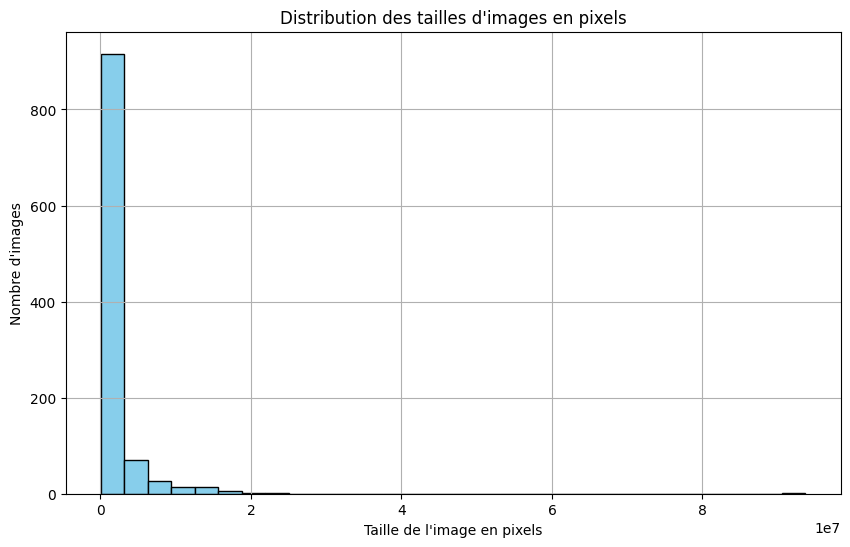

In [ ]:
import matplotlib.pyplot as plt

# Visualisation de la distribution des tailles d'images en pixels avec un histogramme
plt.figure(figsize=(10, 6))
plt.hist(data_im['Taille_img'], bins=30, color='skyblue', edgecolor='black')
plt.title('Distribution des tailles d\'images en pixels')
plt.xlabel('Taille de l\'image en pixels')
plt.ylabel('Nombre d\'images')
plt.grid(True)
plt.show()


==> les images ne sont pas de méme taille

> Ajouter une citation



In [ ]:

# Définir les plages de taille d'images en pixels
plages_taille = [0, 500000, 1000000, 5000000, 10000000, 100000000]

# Calculer la distribution des tailles d'images par plage
df_ditrib_taille = data_im.groupby(pd.cut(data_im['Taille_img'], bins=plages_taille)).size().reset_index(name='Nombre_d_images')

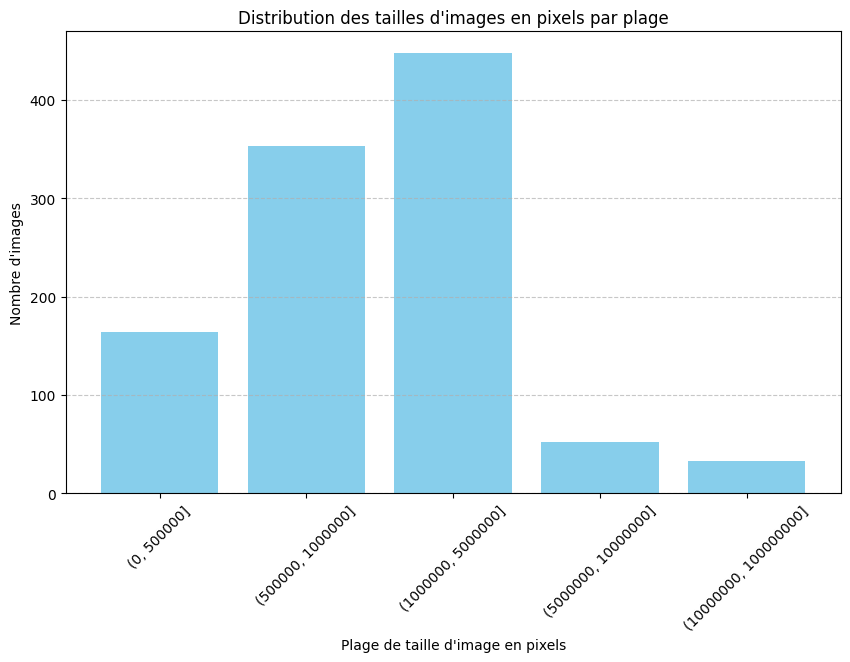

In [ ]:
# Convertir les intervalles en nombres réels pour l'axe x du diagramme en barres
plages_taille_labels = [str(interval) for interval in df_ditrib_taille['Taille_img']]
plages_taille_values = [(interval.left + interval.right) / 2 for interval in df_ditrib_taille['Taille_img']]

# Visualisation de la distribution des tailles d'images avec un diagramme en barres
plt.figure(figsize=(10, 6))
plt.bar(plages_taille_labels, df_ditrib_taille['Nombre_d_images'], color='skyblue')
plt.title('Distribution des tailles d\'images en pixels par plage')
plt.xlabel('Plage de taille d\'image en pixels')
plt.ylabel('Nombre d\'images')
plt.xticks(rotation=45)
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.show()

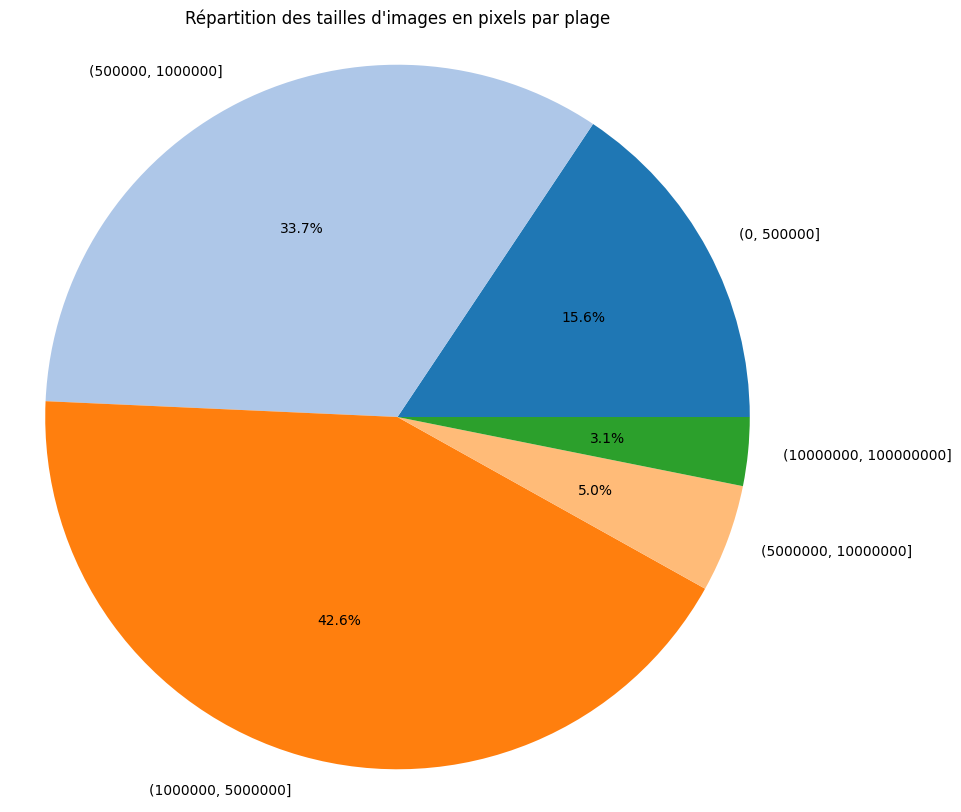

In [ ]:
plt.figure(figsize=(10, 10))
plt.pie(df_ditrib_taille['Nombre_d_images'], labels=df_ditrib_taille['Taille_img'], autopct='%1.1f%%', colors=plt.cm.tab20.colors)
plt.title('Répartition des tailles d\'images en pixels par plage')
plt.axis('equal')
plt.show()


on remarque que les tailles des images appartient aux differentes plages cad y'a pas une plage fixe des images qu'on tous appartient donc il faut redimensionné les images pour qu'on puisse les utiliser dans le reste de notre travail .

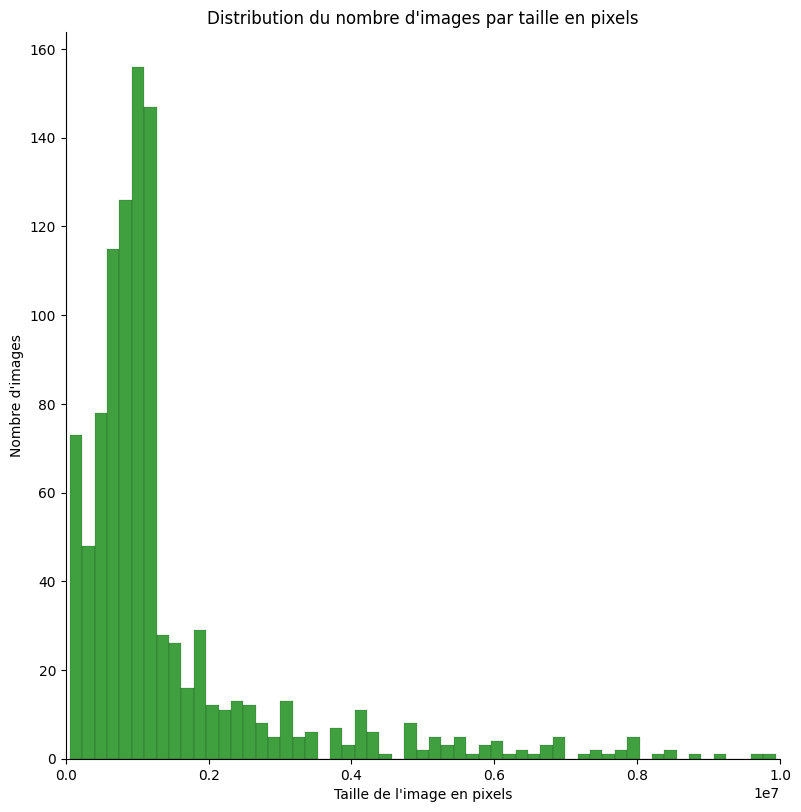

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

# Répartition du nombre d'images par taille de l'image en pixel
sns.displot(data_im['Taille_img'], color='green', height=8)
plt.title('Distribution du nombre d\'images par taille en pixels')
plt.xlabel('Taille de l\'image en pixels')
plt.ylabel('Nombre d\'images')
plt.xlim(0, 10000000)  # Limite de l'axe des x
plt.show()



===> Les images sont de tailles differentes , il faudra  les redimensionner et les normaliser .

In [ ]:
data_im

,image,category,image_path,Largeur_img,Hauteur_img,Plage_hauteur,Plage_largeur,Taille_img
0,55b85ea15a1536d46b7190ad6fff8ce7.jpg,Home Furnishing,/content/drive/MyDrive/Flipkart/Images/55b85ea...,3600.0,3600.0,"[1000, 5000)","[1000, 5000)",12960000
1,7b72c92c2f6c40268628ec5f14c6d590.jpg,Baby Care,/content/drive/MyDrive/Flipkart/Images/7b72c92...,2388.0,1293.0,"[1000, 5000)","[1000, 5000)",3087684
2,64d5d4a258243731dc7bbb1eef49ad74.jpg,Baby Care,/content/drive/MyDrive/Flipkart/Images/64d5d4a...,982.0,729.0,"[500, 1000)","[500, 1000)",715878
3,d4684dcdc759dd9cdf41504698d737d8.jpg,Home Furnishing,/content/drive/MyDrive/Flipkart/Images/d4684dc...,1100.0,831.0,"[500, 1000)","[1000, 5000)",914100
4,6325b6870c54cd47be6ebfbffa620ec7.jpg,Home Furnishing,/content/drive/MyDrive/Flipkart/Images/6325b68...,2670.0,2088.0,"[1000, 5000)","[1000, 5000)",5574960
...,...,...,...,...,...,...,...,...
1045,958f54f4c46b53c8a0a9b8167d9140bc.jpg,Baby Care,/content/drive/MyDrive/Flipkart/Images/958f54f...,1100.0,937.0,"[500, 1000)","[1000, 5000)",1030700
1046,fd6cbcc22efb6b761bd564c28928483c.jpg,Baby Care,/content/drive/MyDrive/Flipkart/Images/fd6cbcc...,900.0,1200.0,"[1000, 5000)","[500, 1000)",1080000
1047,5912e037d12774bb73a2048f35a00009.jpg,Baby Care,/content/drive/MyDrive/Flipkart/Images/5912e03...,1100.0,1011.0,"[1000, 5000)","[1000, 5000)",1112100
1048,c3edc504d1b4f0ba6224fa53a43a7ad6.jpg,Baby Care,/content/drive/MyDrive/Flipkart/Images/c3edc50...,900.0,1200.0,"[1000, 5000)","[500, 1000)",1080000


In [ ]:
# Format des images
data_im['Format_img'] = [Image.open(row).mode for row in data_im['image_path']]
print(data_im.groupby('Format_img').count())

/usr/local/lib/python3.10/dist-packages/PIL/Image.py:3167: DecompressionBombWarning: Image size (93680328 pixels) exceeds limit of 89478485 pixels, could be decompression bomb DOS attack.
  warnings.warn(


            image  category  image_path  Largeur_img  Plage_largeur  \
Format_img                                                            
RGB          1049      1049        1049         1049           1049   

            Hauteur_img  Plage_hauteur  Taille_img  
Format_img                                          
RGB                1049           1049        1049  


In [ ]:
import os

# Fonction pour vérifier l'extension de fichier
def check_extension(image_path):
    _, extension = os.path.splitext(image_path)
    return extension.lower() == '.jpg'

# Appliquer la fonction à chaque chemin d'image dans votre DataFrame data_im
data_im['Is_JPG'] = data_im['image_path'].apply(check_extension)

# Afficher le nombre d'images avec l'extension .jpg
num_jpg_images = data_im['Is_JPG'].sum()
total_images = len(data_im)
print(f"Nombre total d'images : {total_images}")
print(f"Nombre d'images avec l'extension .jpg : {num_jpg_images}")


Nombre total d'images : 1049
Nombre d'images avec l'extension .jpg : 1049


**conclusion : tous les images ayant le format RGB et tous les images se termine avec l'extension .jpg **

partie pour esseyer le VGG

In [ ]:
from PIL import Image

# Définir une fonction pour redimensionner les images
def cnn_redimensionner_image(image_path):
    # Ouvrir l'image
    image = Image.open(image_path)
    # Redimensionner l'image à 224x224 pixels
    image_redimensionnee = image.resize((224, 224))
    return image_redimensionnee


In [ ]:
# Redimensionner les images à 224x224 pixels et les convertir en tableaux NumPy
data_im['image_redim_array'] = data_im['image_path'].apply(lambda x: np.array(cnn_redimensionner_image(x)))

/usr/local/lib/python3.10/dist-packages/PIL/Image.py:3167: DecompressionBombWarning: Image size (93680328 pixels) exceeds limit of 89478485 pixels, could be decompression bomb DOS attack.
  warnings.warn(


In [ ]:
data_im.head()


,image,category,image_path,Largeur_img,Hauteur_img,Plage_hauteur,Plage_largeur,Taille_img,image_redim_array
0,55b85ea15a1536d46b7190ad6fff8ce7.jpg,Home Furnishing,/content/drive/MyDrive/Flipkart/Images/55b85ea...,3600.0,3600.0,"[1000, 5000)","[1000, 5000)",12960000,"[[[203, 198, 189], [203, 198, 188], [203, 198,..."
1,7b72c92c2f6c40268628ec5f14c6d590.jpg,Baby Care,/content/drive/MyDrive/Flipkart/Images/7b72c92...,2388.0,1293.0,"[1000, 5000)","[1000, 5000)",3087684,"[[[255, 255, 255], [255, 255, 255], [255, 255,..."
2,64d5d4a258243731dc7bbb1eef49ad74.jpg,Baby Care,/content/drive/MyDrive/Flipkart/Images/64d5d4a...,982.0,729.0,"[500, 1000)","[500, 1000)",715878,"[[[255, 255, 255], [255, 255, 255], [255, 255,..."
3,d4684dcdc759dd9cdf41504698d737d8.jpg,Home Furnishing,/content/drive/MyDrive/Flipkart/Images/d4684dc...,1100.0,831.0,"[500, 1000)","[1000, 5000)",914100,"[[[255, 255, 255], [255, 255, 255], [255, 255,..."
4,6325b6870c54cd47be6ebfbffa620ec7.jpg,Home Furnishing,/content/drive/MyDrive/Flipkart/Images/6325b68...,2670.0,2088.0,"[1000, 5000)","[1000, 5000)",5574960,"[[[82, 77, 71], [123, 114, 111], [155, 146, 14..."


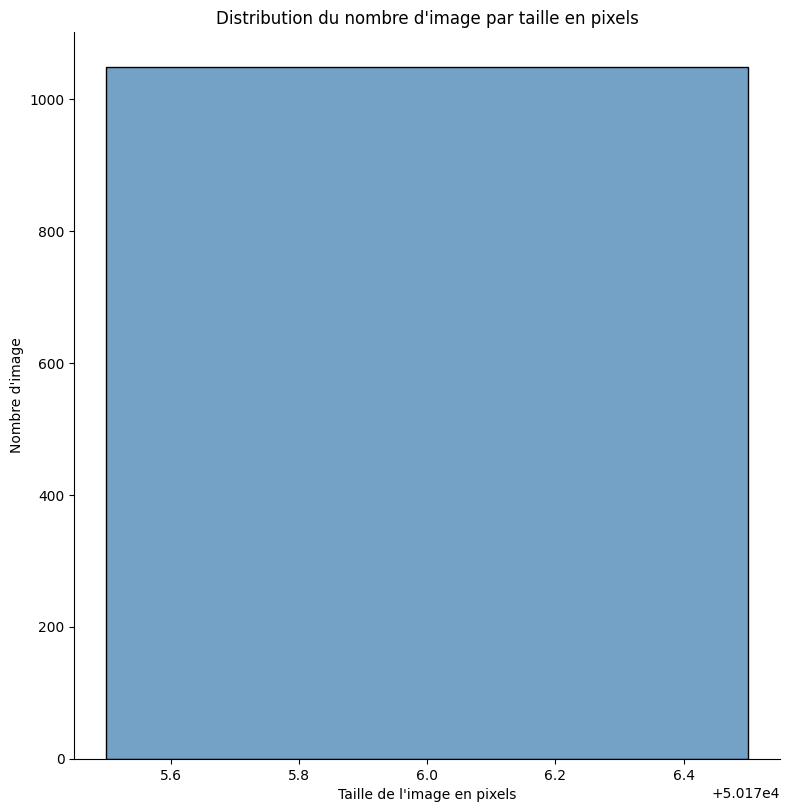

In [ ]:
# Visualiser la distribution du nombre d'images par taille en pixels
sns.displot(data_im['image_redim_array'].apply(lambda x: x.shape[0] * x.shape[1]), color='SteelBlue', height=8)
plt.title('Distribution du nombre d\'image par taille en pixels')
plt.xlabel('Taille de l\'image en pixels')
plt.ylabel('Nombre d\'image')
plt.show()

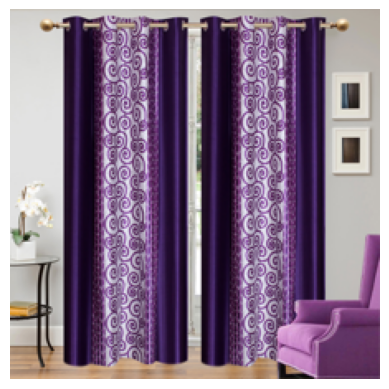

In [ ]:
import matplotlib.pyplot as plt

# Sélectionner une image redimensionnée (par exemple, la première image)
image_redim_array = data_im['image_redim_array'].iloc[0]

# Afficher l'image redimensionnée
plt.imshow(image_redim_array)
plt.axis('off')
plt.show()


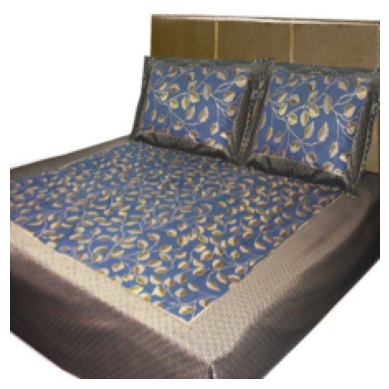

In [ ]:
import matplotlib.pyplot as plt

# Sélectionner une image redimensionnée (par exemple, la première image)
image_redim_array = data_im['image_redim_array'].iloc[3]

# Afficher l'image redimensionnée
plt.imshow(image_redim_array)
plt.axis('off')
plt.show()


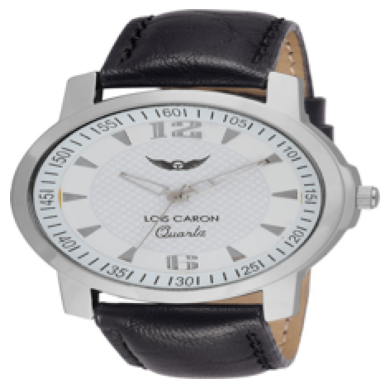

In [ ]:
import matplotlib.pyplot as plt

# Sélectionner une image redimensionnée (par exemple, la première image)
image_redim_array = data_im['image_redim_array'].iloc[12]

# Afficher l'image redimensionnée
plt.imshow(image_redim_array)
plt.axis('off')
plt.show()

====> c"est bon on a réussi a appliquer le redimensionnemnt sur nos images

In [ ]:
# Utilisation de VGG16 pré-entraîné sur ImageNet avec les images redimensionnées
# Liste pour stocker les features VGG16
vgg16_all_features = []

# Instanciation du modèle VGG16 pré-entraîné
model_vgg16 = VGG16(weights='imagenet', include_top=False)
# Résumé de l'architecture du modèle
model_vgg16.summary()

for img_array in data_im['image_redim_array']:
    # Redimensionner l'image en un tableau de taille (1, 224, 224, 3)
    img = np.expand_dims(img_array, axis=0)
    # Préparer de nouvelles entrées pour le réseau.
    img = preprocess_input(img)

    # obtenir une prédiction de la probabilité d'appartenance
    # de l'image à chacun des 1000 types d'objets connus.
    vgg16_feature = model_vgg16.predict(img)
    # Ajouter la feature prédite en nparray à la liste
    vgg16_all_features.append(np.array(vgg16_feature).flatten())

vgg16_all_features = np.array(vgg16_all_features)

Model: "vgg16"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_2 (InputLayer)        [(None, None, None, 3)]   0         
                                                                 
 block1_conv1 (Conv2D)       (None, None, None, 64)    1792      
                                                                 
 block1_conv2 (Conv2D)       (None, None, None, 64)    36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, None, None, 64)    0         
                                                                 
 block2_conv1 (Conv2D)       (None, None, None, 128)   73856     
                                                                 
 block2_conv2 (Conv2D)       (None, None, None, 128)   147584    
                                                                 
 block2_pool (MaxPooling2D)  (None, None, None, 128)   0     

Association des features extraites a leurs images spécifiques  


In [ ]:
# Association des features à chaque image
data_im['features'] = vgg16_all_features.tolist()

In [ ]:
# Création d'un DataFrame de travail
df = data_im[['image', 'image_path', 'category', 'features','image_redim_array']]

# Constitution du DataFrame de vecteurs de BOVW VGG16
df_vgg16_vectors = pd.DataFrame(vgg16_all_features)

In [ ]:
df.head()

,image,image_path,category,features,image_redim_array
0,55b85ea15a1536d46b7190ad6fff8ce7.jpg,/content/drive/MyDrive/Flipkart/Images/55b85ea...,Home Furnishing,"[0.0, 0.0, 0.0, 0.0, 3.1594419479370117, 0.0, ...","[[[203, 198, 189], [203, 198, 188], [203, 198,..."
1,7b72c92c2f6c40268628ec5f14c6d590.jpg,/content/drive/MyDrive/Flipkart/Images/7b72c92...,Baby Care,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[[[255, 255, 255], [255, 255, 255], [255, 255,..."
2,64d5d4a258243731dc7bbb1eef49ad74.jpg,/content/drive/MyDrive/Flipkart/Images/64d5d4a...,Baby Care,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[[[255, 255, 255], [255, 255, 255], [255, 255,..."
3,d4684dcdc759dd9cdf41504698d737d8.jpg,/content/drive/MyDrive/Flipkart/Images/d4684dc...,Home Furnishing,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[[[255, 255, 255], [255, 255, 255], [255, 255,..."
4,6325b6870c54cd47be6ebfbffa620ec7.jpg,/content/drive/MyDrive/Flipkart/Images/6325b68...,Home Furnishing,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[[[82, 77, 71], [123, 114, 111], [155, 146, 14..."


Reduction de dimension

In [ ]:
from sklearn.manifold import TSNE
import matplotlib.pyplot as plt
import seaborn as sns

# Réduction en 2 dimensions avec T-SNE
tsne = TSNE(n_components=2, random_state=42)
features_2d = tsne.fit_transform(df_vgg16_vectors)


<ipython-input-85-686ba7e96b67>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['tsne_x'] = features_2d[:, 0]
<ipython-input-85-686ba7e96b67>:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['tsne_y'] = features_2d[:, 1]
<ipython-input-85-686ba7e96b67>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

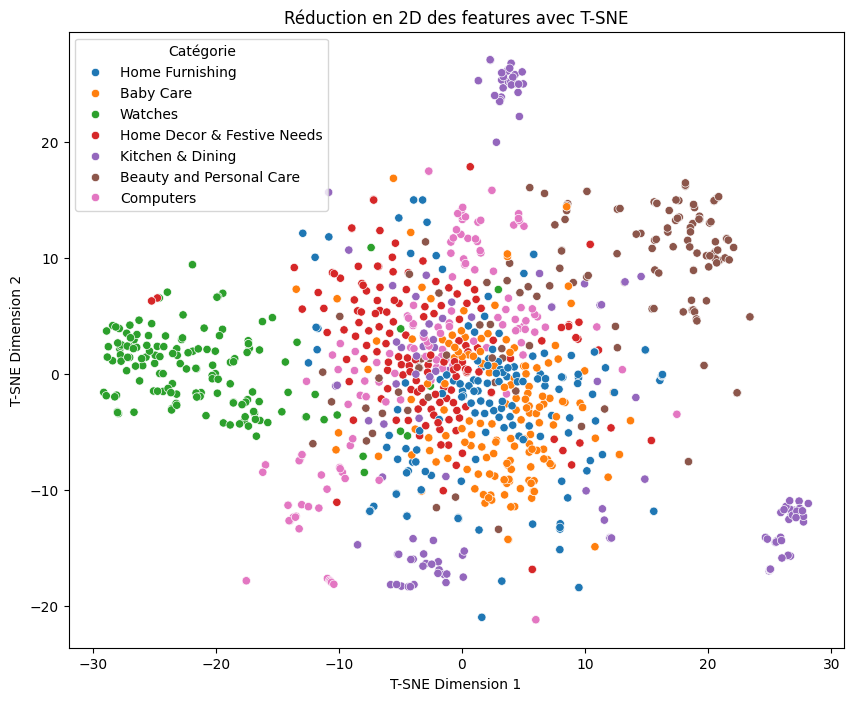

In [ ]:
# Ajout des données réduites au DataFrame
df['tsne_x'] = features_2d[:, 0]
df['tsne_y'] = features_2d[:, 1]

# Nettoyer le nom de la colonne des éventuels espaces supplémentaires
df['category'] = df['category'].str.strip()

# Visualisation
plt.figure(figsize=(10, 8))
sns.scatterplot(x='tsne_x', y='tsne_y', hue='category', data=df, palette='tab10')
plt.title('Réduction en 2D des features avec T-SNE')
plt.xlabel('T-SNE Dimension 1')
plt.ylabel('T-SNE Dimension 2')
plt.legend(title='Catégorie')
plt.show()


In [ ]:
from sklearn.cluster import KMeans

# Instanciation du modèle KMeans avec initialisation normale
kmeans = KMeans(n_clusters=7, init='random', n_init=10, max_iter=200, random_state=42)

# Ajustement du modèle aux données réduites en 2 dimensions
kmeans.fit(features_2d)

# Ajout des étiquettes de cluster au DataFrame
df['cluster'] = kmeans.labels_


<ipython-input-87-b5c1f27ae309>:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['cluster'] = kmeans.labels_


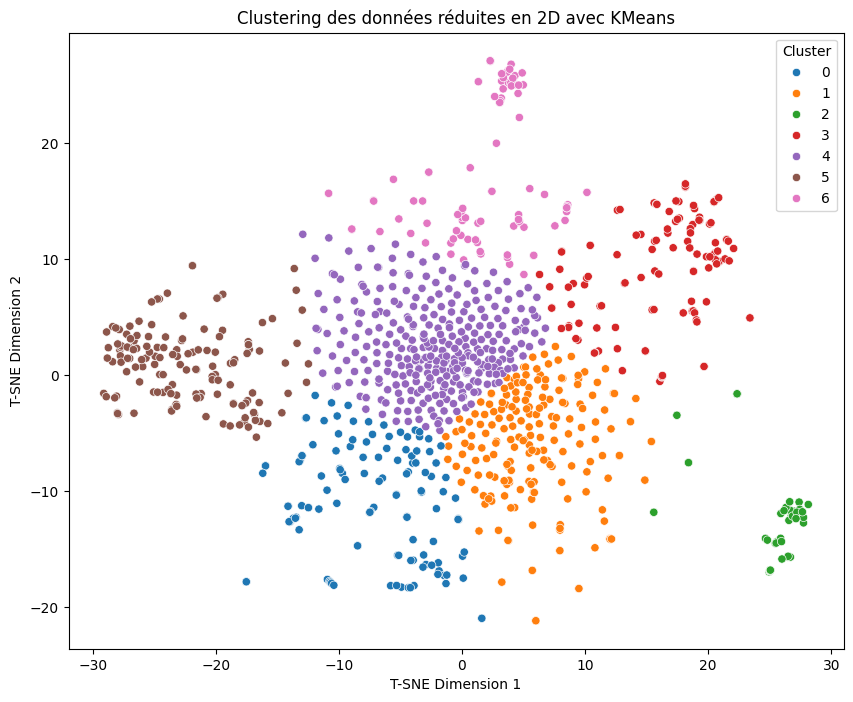

In [ ]:

# Affichage des résultats
plt.figure(figsize=(10, 8))
sns.scatterplot(x='tsne_x', y='tsne_y', hue='cluster', data=df, palette='tab10', legend='full')
plt.title('Clustering des données réduites en 2D avec KMeans')
plt.xlabel('T-SNE Dimension 1')
plt.ylabel('T-SNE Dimension 2')
plt.legend(title='Cluster')
plt.show()


<ipython-input-91-79856322d757>:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['cluster'] = cluster_labels


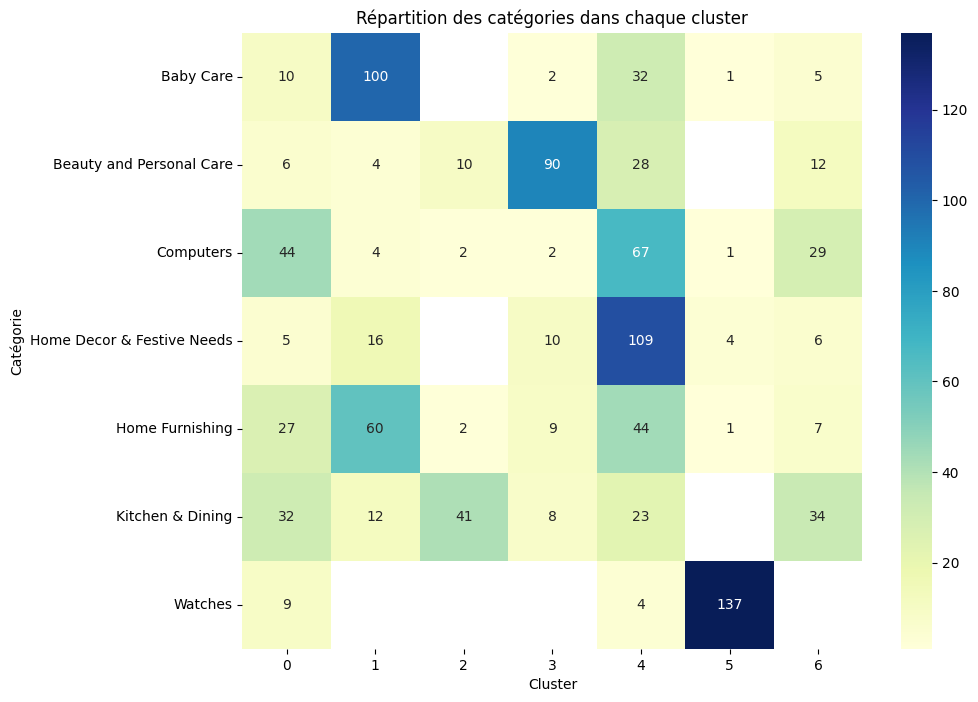

In [ ]:
# Prédiction des clusters pour chaque échantillon
cluster_labels = kmeans.predict(features_2d)

# Ajout des étiquettes de cluster au DataFrame
df['cluster'] = cluster_labels


# Compter le nombre d'occurrences de chaque catégorie dans chaque cluster
category_cluster_counts = df.groupby(['category', 'cluster']).size().reset_index(name='count')

# Créer un tableau croisé dynamique pour une meilleure visualisation
pivot_table = category_cluster_counts.pivot(index='category', columns='cluster', values='count')

# Créer un heatmap
plt.figure(figsize=(10, 8))
sns.heatmap(pivot_table, cmap='YlGnBu', annot=True, fmt='.0f')  # Utiliser '.0f' pour les flottants
plt.title('Répartition des catégories dans chaque cluster')
plt.xlabel('Cluster')
plt.ylabel('Catégorie')
plt.show()


In [ ]:
# Regrouper les données par cluster et par catégorie, puis compter le nombre d'images par catégorie
count_par_cluster_et_categorie = df.groupby(['cluster', 'category']).size().reset_index(name='count')

# Afficher le nombre d'images par catégorie dans chaque cluster
for cluster in count_par_cluster_et_categorie['cluster'].unique():
    print(f"Cluster {cluster}:")
    cluster_data = count_par_cluster_et_categorie[count_par_cluster_et_categorie['cluster'] == cluster]
    for index, row in cluster_data.iterrows():
        print(f"   Catégorie: {row['category']}, Nombre d'images: {row['count']}")


Cluster 0:
   Catégorie: Baby Care, Nombre d'images: 10
   Catégorie: Beauty and Personal Care, Nombre d'images: 6
   Catégorie: Computers, Nombre d'images: 44
   Catégorie: Home Decor & Festive Needs, Nombre d'images: 5
   Catégorie: Home Furnishing, Nombre d'images: 27
   Catégorie: Kitchen & Dining, Nombre d'images: 32
   Catégorie: Watches, Nombre d'images: 9
Cluster 1:
   Catégorie: Baby Care, Nombre d'images: 100
   Catégorie: Beauty and Personal Care, Nombre d'images: 4
   Catégorie: Computers, Nombre d'images: 4
   Catégorie: Home Decor & Festive Needs, Nombre d'images: 16
   Catégorie: Home Furnishing, Nombre d'images: 60
   Catégorie: Kitchen & Dining, Nombre d'images: 12
Cluster 2:
   Catégorie: Beauty and Personal Care, Nombre d'images: 10
   Catégorie: Computers, Nombre d'images: 2
   Catégorie: Home Furnishing, Nombre d'images: 2
   Catégorie: Kitchen & Dining, Nombre d'images: 41
Cluster 3:
   Catégorie: Baby Care, Nombre d'images: 2
   Catégorie: Beauty and Personal Car

In [ ]:
from sklearn.metrics import adjusted_rand_score

# Calcul de l'indice de similarité
similarity_score = adjusted_rand_score(df['category'], df['cluster'])

# Affichage de l'indice de similarité
print("Indice de similarité entre les catégories réelles et les clusters:", similarity_score)


Indice de similarité entre les catégories réelles et les clusters: 0.2754286769365872


Utilisons VGG19 ( autre version de VGG , elle a une profondeur légèrement plus grande avec plus de couches. Cela peut conduire à une meilleure capacité de représentation des caractéristiques )

In [ ]:
from keras.applications.vgg19 import VGG19
from keras.applications.vgg19 import preprocess_input


# Liste pour stocker les features VGG19
vgg19_all_features = []

# Instanciation du modèle VGG19 pré-entraîné
model_vgg19 = VGG19(weights='imagenet', include_top=False)
# Résumé de l'architecture du modèle
model_vgg19.summary()

for img_array in data_im['image_redim_array']:
    # Redimensionner l'image en un tableau de taille (1, 224, 224, 3)
    img = np.expand_dims(img_array, axis=0)
    # Préparer de nouvelles entrées pour le réseau.
    img = preprocess_input(img)

    # obtenir une prédiction de la probabilité d'appartenance
    # de l'image à chacun des 1000 types d'objets connus.
    vgg19_feature = model_vgg19.predict(img)
    # Ajouter la feature prédite en nparray à la liste
    vgg19_all_features.append(np.array(vgg19_feature).flatten())

vgg19_all_features = np.array(vgg19_all_features)


80134624/80134624 [==============================] - 17s 0us/step
Model: "vgg19"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, None, None, 3)]   0         
                                                                 
 block1_conv1 (Conv2D)       (None, None, None, 64)    1792      
                                                                 
 block1_conv2 (Conv2D)       (None, None, None, 64)    36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, None, None, 64)    0         
                                                                 
 block2_conv1 (Conv2D)       (None, None, None, 128)   73856     
                                                                 
 block2_conv2 (Conv2D)       (None, None, None, 128)   147584    
                                                             

In [ ]:
# Association des features à chaque image
data_im['features_VGG19'] = vgg19_all_features.tolist()

# Création d'un DataFrame de travail
df_VGG19 = data_im[['image', 'image_path', 'category', 'features_VGG19', 'image_redim_array']]

# Constitution du DataFrame de vecteurs de BOVW VGG19
df_vgg19_vectors = pd.DataFrame(vgg19_all_features)


In [ ]:
df_VGG19.head()

,image,image_path,category,features_VGG19,image_redim_array
0,55b85ea15a1536d46b7190ad6fff8ce7.jpg,/content/drive/MyDrive/Flipkart/Images/55b85ea...,Home Furnishing,"[0.0, 0.0, 0.0, 0.0, 3.072187900543213, 28.586...","[[[203, 198, 189], [203, 198, 188], [203, 198,..."
1,7b72c92c2f6c40268628ec5f14c6d590.jpg,/content/drive/MyDrive/Flipkart/Images/7b72c92...,Baby Care,"[0.0, 0.0, 0.0, 0.0, 5.15006160736084, 0.0, 0....","[[[255, 255, 255], [255, 255, 255], [255, 255,..."
2,64d5d4a258243731dc7bbb1eef49ad74.jpg,/content/drive/MyDrive/Flipkart/Images/64d5d4a...,Baby Care,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[[[255, 255, 255], [255, 255, 255], [255, 255,..."
3,d4684dcdc759dd9cdf41504698d737d8.jpg,/content/drive/MyDrive/Flipkart/Images/d4684dc...,Home Furnishing,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[[[255, 255, 255], [255, 255, 255], [255, 255,..."
4,6325b6870c54cd47be6ebfbffa620ec7.jpg,/content/drive/MyDrive/Flipkart/Images/6325b68...,Home Furnishing,"[0.0, 0.0, 18.54818344116211, 0.0, 0.0, 0.0, 0...","[[[82, 77, 71], [123, 114, 111], [155, 146, 14..."


In [ ]:
from sklearn.manifold import TSNE
import matplotlib.pyplot as plt
import seaborn as sns

# Réduction en 2 dimensions avec T-SNE
tsne = TSNE(n_components=2, random_state=42)
features_2d = tsne.fit_transform(df_vgg19_vectors)

# Ajout des données réduites au DataFrame
df_VGG19.loc[:, 'tsne_x'] = features_2d[:, 0]
df_VGG19.loc[:, 'tsne_y'] = features_2d[:, 1]

# Nettoyer le nom de la colonne des éventuels espaces supplémentaires
df_VGG19.loc[:, 'category'] = df_VGG19['category'].str.strip()




<ipython-input-70-e84140d8b50a>:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_VGG19.loc[:, 'tsne_x'] = features_2d[:, 0]
<ipython-input-70-e84140d8b50a>:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_VGG19.loc[:, 'tsne_y'] = features_2d[:, 1]


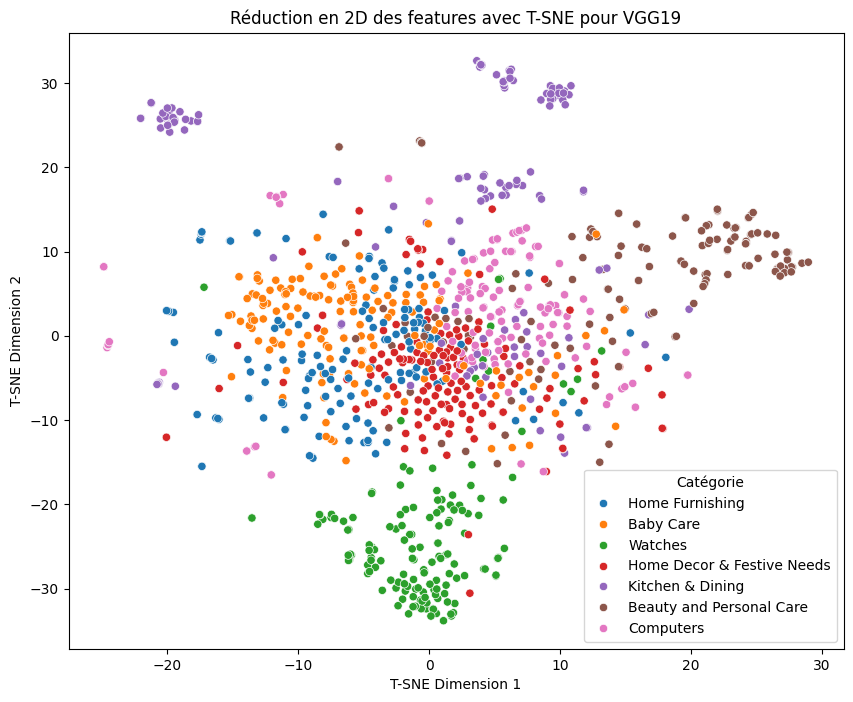

In [ ]:
# Visualisation
plt.figure(figsize=(10, 8))
sns.scatterplot(x='tsne_x', y='tsne_y', hue='category', data=df_VGG19, palette='tab10')
plt.title('Réduction en 2D des features avec T-SNE pour VGG19')
plt.xlabel('T-SNE Dimension 1')
plt.ylabel('T-SNE Dimension 2')
plt.legend(title='Catégorie')
plt.show()


Clustering

In [ ]:
from sklearn.cluster import KMeans

# Instanciation du modèle KMeans avec initialisation normale
kmeans = KMeans(n_clusters=7, init='random', n_init=10, max_iter=200, random_state=42)

# Ajustement du modèle aux données réduites en 2 dimensions
kmeans.fit(features_2d)



KMeans(init='random', max_iter=200, n_clusters=7, n_init=10, random_state=42)

<ipython-input-73-60dc4dcefbff>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_VGG19.loc[:, 'cluster'] = kmeans.labels_


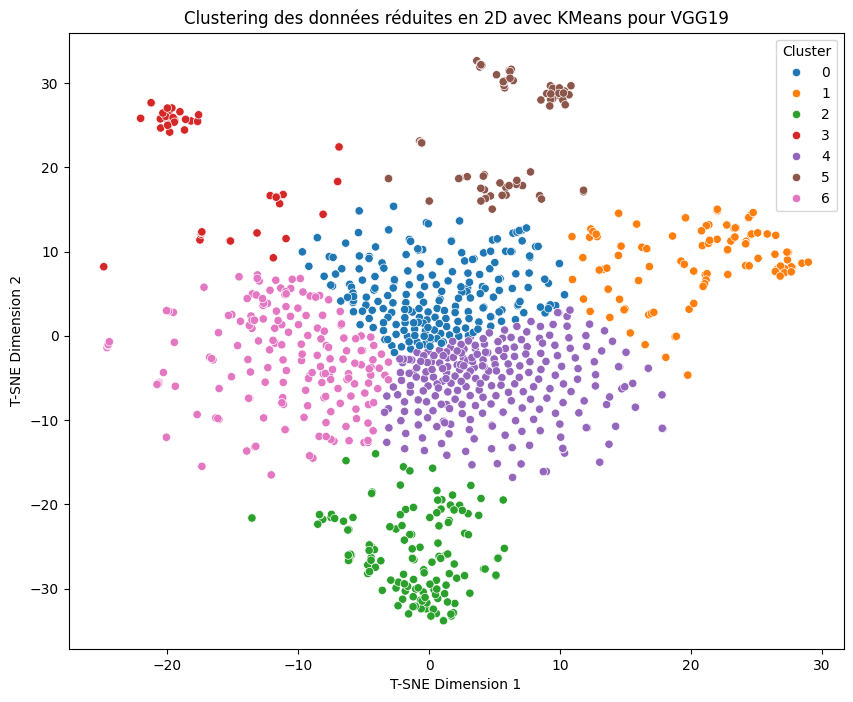

In [ ]:
# Ajout des étiquettes de cluster au DataFrame
df_VGG19.loc[:, 'cluster'] = kmeans.labels_

# Affichage des résultats
plt.figure(figsize=(10, 8))
sns.scatterplot(x='tsne_x', y='tsne_y', hue='cluster', data=df_VGG19, palette='tab10', legend='full')
plt.title('Clustering des données réduites en 2D avec KMeans pour VGG19')
plt.xlabel('T-SNE Dimension 1')
plt.ylabel('T-SNE Dimension 2')
plt.legend(title='Cluster')
plt.show()


In [ ]:
from sklearn.metrics import adjusted_rand_score

# Calcul de l'indice de similarité (Adjusted Rand Score)
similarity_score = adjusted_rand_score(df_VGG19['category'], df_VGG19['cluster'])

print("Adjusted Rand Score:", similarity_score)


Adjusted Rand Score: 0.2888189935217053


In [ ]:
# 1. Associez chaque image à son cluster prédit
df_VGG19['predicted_cluster'] = kmeans.labels_

# 2. Pour chaque catégorie, comptez le nombre d'images appartenant à cette catégorie dans chaque cluster
category_counts_per_cluster = df_VGG19.groupby(['category', 'predicted_cluster']).size()

# 3. Calculez la précision pour chaque catégorie dans chaque cluster
precision_scores = {}
for category in df_VGG19['category'].unique():
    precision_scores[category] = {}
    total_category_count = len(df_VGG19[df_VGG19['category'] == category])
    for cluster in range(7):  # 7 est le nombre de clusters
        correctly_assigned_count = category_counts_per_cluster.get((category, cluster), 0)
        precision = correctly_assigned_count / total_category_count
        precision_scores[category][cluster] = precision

# Afficher les résultats
for category, precision_scores_per_cluster in precision_scores.items():
    print(f"Catégorie : {category}")
    for cluster, precision in precision_scores_per_cluster.items():
        print(f"  Cluster {cluster} : Précision = {precision:.2f}")


Catégorie : Home Furnishing
  Cluster 0 : Précision = 0.31
  Cluster 1 : Précision = 0.01
  Cluster 2 : Précision = 0.01
  Cluster 3 : Précision = 0.08
  Cluster 4 : Précision = 0.11
  Cluster 5 : Précision = 0.00
  Cluster 6 : Précision = 0.48
Catégorie : Baby Care
  Cluster 0 : Précision = 0.31
  Cluster 1 : Précision = 0.01
  Cluster 2 : Précision = 0.01
  Cluster 3 : Précision = 0.00
  Cluster 4 : Précision = 0.15
  Cluster 5 : Précision = 0.00
  Cluster 6 : Précision = 0.52
Catégorie : Watches
  Cluster 0 : Précision = 0.02
  Cluster 1 : Précision = 0.00
  Cluster 2 : Précision = 0.90
  Cluster 3 : Précision = 0.00
  Cluster 4 : Précision = 0.07
  Cluster 5 : Précision = 0.00
  Cluster 6 : Précision = 0.01
Catégorie : Home Decor & Festive Needs
  Cluster 0 : Précision = 0.19
  Cluster 1 : Précision = 0.00
  Cluster 2 : Précision = 0.01
  Cluster 3 : Précision = 0.00
  Cluster 4 : Précision = 0.66
  Cluster 5 : Précision = 0.01
  Cluster 6 : Précision = 0.13
Catégorie : Kitchen & D

<ipython-input-75-bd8c4bcccff3>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_VGG19['predicted_cluster'] = kmeans.labels_


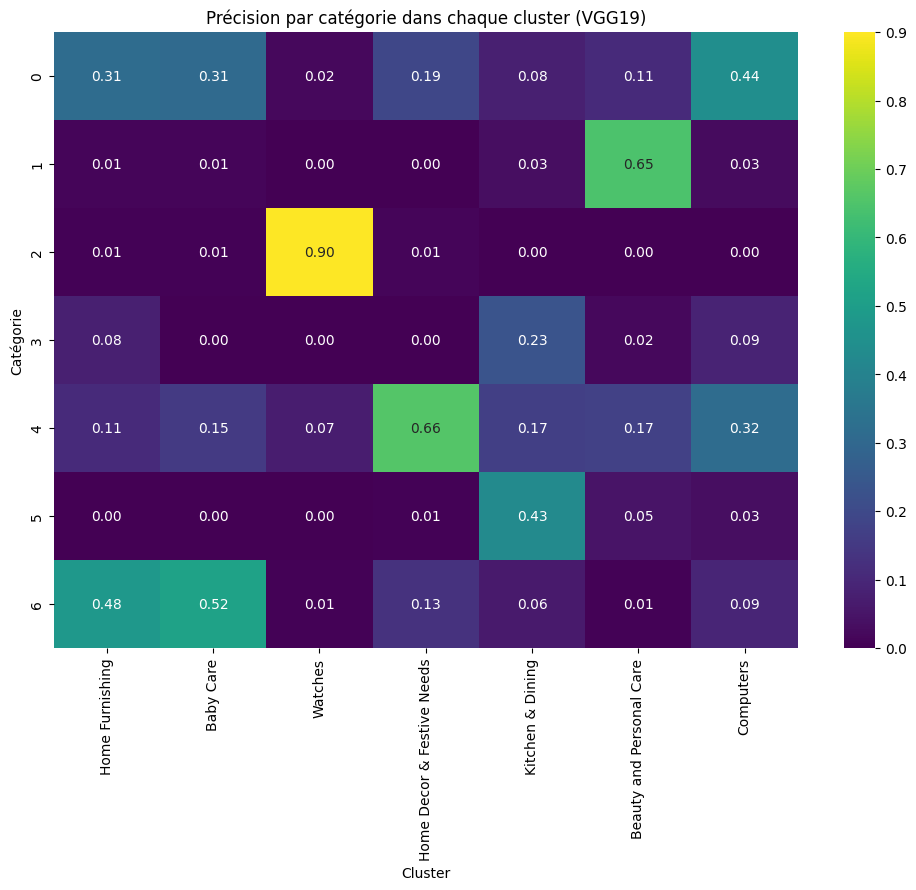

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

# Convertir les scores de précision en DataFrame pour faciliter la manipulation
precision_df = pd.DataFrame(precision_scores)

# Afficher un heatmap
plt.figure(figsize=(12, 8))
sns.heatmap(precision_df, cmap='viridis', annot=True, fmt=".2f")
plt.title('Précision par catégorie dans chaque cluster (VGG19)')
plt.xlabel('Cluster')
plt.ylabel('Catégorie')
plt.show()


In [ ]:
df_VGG19.head()

,image,image_path,category,features_VGG19,image_redim_array,tsne_x,tsne_y,cluster,predicted_cluster
0,55b85ea15a1536d46b7190ad6fff8ce7.jpg,/content/drive/MyDrive/Flipkart/Images/55b85ea...,Home Furnishing,"[0.0, 0.0, 0.0, 0.0, 3.072187900543213, 28.586...","[[[203, 198, 189], [203, 198, 188], [203, 198,...",-10.937926,11.532439,3,3
1,7b72c92c2f6c40268628ec5f14c6d590.jpg,/content/drive/MyDrive/Flipkart/Images/7b72c92...,Baby Care,"[0.0, 0.0, 0.0, 0.0, 5.15006160736084, 0.0, 0....","[[[255, 255, 255], [255, 255, 255], [255, 255,...",-8.037173,-7.357243,6,6
2,64d5d4a258243731dc7bbb1eef49ad74.jpg,/content/drive/MyDrive/Flipkart/Images/64d5d4a...,Baby Care,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[[[255, 255, 255], [255, 255, 255], [255, 255,...",-5.785786,2.851175,0,0
3,d4684dcdc759dd9cdf41504698d737d8.jpg,/content/drive/MyDrive/Flipkart/Images/d4684dc...,Home Furnishing,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[[[255, 255, 255], [255, 255, 255], [255, 255,...",-7.518848,-9.010772,6,6
4,6325b6870c54cd47be6ebfbffa620ec7.jpg,/content/drive/MyDrive/Flipkart/Images/6325b68...,Home Furnishing,"[0.0, 0.0, 18.54818344116211, 0.0, 0.0, 0.0, 0...","[[[82, 77, 71], [123, 114, 111], [155, 146, 14...",2.477007,9.855294,0,0


ResNet

In [ ]:
# Utilisation de ResNet152 pré-entraîné sur ImageNet avec les images
from keras.applications.resnet import preprocess_input
from keras.applications import ResNet152

# Liste pour stocker les features de ResNet152
rn152_all_features = []

# Instanciation du modèle ResNet152 pré-entraîné
model_rn152 = ResNet152(weights='imagenet', include_top=False)
# Résumé de l'architecture du modèle
model_rn152.summary()

for img_array in data_im['image_redim_array']:
    # Redimensionner l'image en un tableau de taille (1, 224, 224, 3)
    img = np.expand_dims(img_array, axis=0)
    # Prétraitement de l'image pour l'adapter au format attendu par ResNet152
    img = preprocess_input(img)

    # Obtenir les features extraites par ResNet152 pour l'image
    rn152_feature = model_rn152.predict(img)
    # Ajouter les features extraites à la liste
    rn152_all_features.append(np.array(rn152_feature).flatten())

# Convertir la liste de features en un tableau numpy
rn152_all_features = np.array(rn152_all_features)


Model: "resnet152"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, None, None, 3)]      0         []                            
                                                                                                  
 conv1_pad (ZeroPadding2D)   (None, None, None, 3)        0         ['input_1[0][0]']             
                                                                                                  
 conv1_conv (Conv2D)         (None, None, None, 64)       9472      ['conv1_pad[0][0]']           
                                                                                                  
 conv1_bn (BatchNormalizati  (None, None, None, 64)       256       ['conv1_conv[0][0]']          
 on)                                                                                      

In [ ]:
# Dataframe de sauvegarde des BOVW ResNet152
# Association des features à chaque image
data_im['features_resnet'] = rn152_all_features.tolist()



# Dataframe de travail
df_ResNet = data_im[['image', 'image_path', 'category', 'features_resnet','image_redim_array']]

# Constituer le dataframe de vecteurs de BOVW ResNet152
df_rn152_vectors = pd.DataFrame.from_records(rn152_all_features)


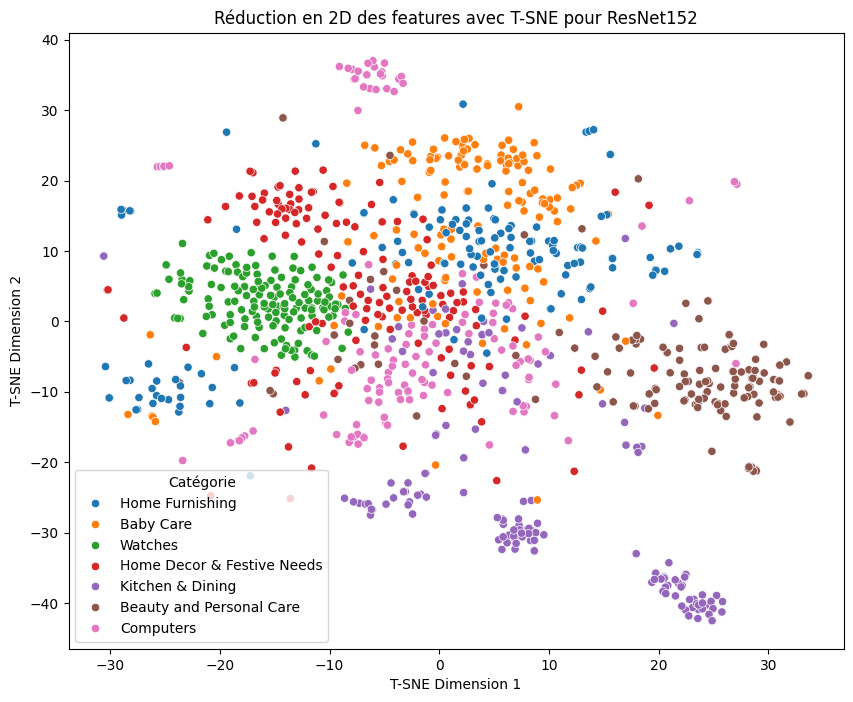

In [ ]:
from sklearn.manifold import TSNE

# Réduction en 2 dimensions avec T-SNE
tsne = TSNE(n_components=2, random_state=42)
features_2d_rn152 = tsne.fit_transform(df_rn152_vectors)

# Ajout des données réduites au DataFrame
df_ResNet.loc[:, 'tsne_x'] = features_2d_rn152[:, 0]
df_ResNet.loc[:, 'tsne_y'] = features_2d_rn152[:, 1]

# Visualisation
plt.figure(figsize=(10, 8))
sns.scatterplot(x='tsne_x', y='tsne_y', hue='category', data=df_ResNet, palette='tab10')
plt.title('Réduction en 2D des features avec T-SNE pour ResNet152')
plt.xlabel('T-SNE Dimension 1')
plt.ylabel('T-SNE Dimension 2')
plt.legend(title='Catégorie')
plt.show()


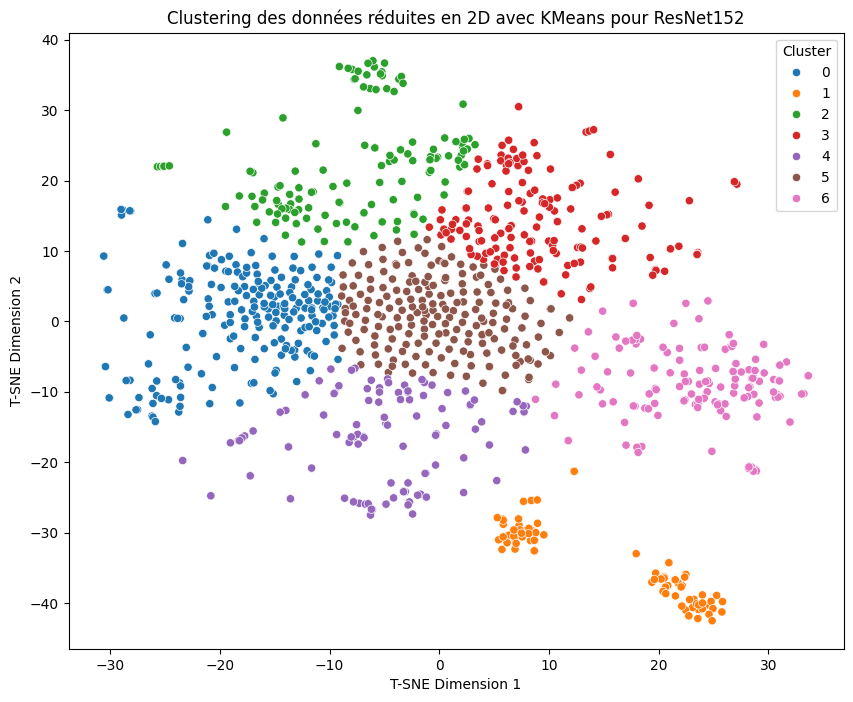

In [ ]:
from sklearn.cluster import KMeans

# Instanciation du modèle KMeans avec initialisation normale
kmeans_rn152 = KMeans(n_clusters=7, init='random', n_init=10, max_iter=200, random_state=42)

# Ajustement du modèle aux données réduites en 2 dimensions
kmeans_rn152.fit(features_2d_rn152)

# Ajout des étiquettes de cluster au DataFrame
df_ResNet.loc[:, 'cluster'] = kmeans_rn152.labels_

# Affichage des résultats
plt.figure(figsize=(10, 8))
sns.scatterplot(x='tsne_x', y='tsne_y', hue='cluster', data=df_ResNet, palette='tab10', legend='full')
plt.title('Clustering des données réduites en 2D avec KMeans pour ResNet152')
plt.xlabel('T-SNE Dimension 1')
plt.ylabel('T-SNE Dimension 2')
plt.legend(title='Cluster')
plt.show()


In [ ]:
df_ResNet.head()

,image,image_path,category,features_resnet,image_redim_array,tsne_x,tsne_y,cluster
0,55b85ea15a1536d46b7190ad6fff8ce7.jpg,/content/drive/MyDrive/Flipkart/Images/55b85ea...,Home Furnishing,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[[[203, 198, 189], [203, 198, 188], [203, 198,...",20.551064,7.127800,3
1,7b72c92c2f6c40268628ec5f14c6d590.jpg,/content/drive/MyDrive/Flipkart/Images/7b72c92...,Baby Care,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[[[255, 255, 255], [255, 255, 255], [255, 255,...",15.424443,15.218757,3
2,64d5d4a258243731dc7bbb1eef49ad74.jpg,/content/drive/MyDrive/Flipkart/Images/64d5d4a...,Baby Care,"[0.0, 0.0, 0.1294439435005188, 0.0, 0.0, 0.0, ...","[[[255, 255, 255], [255, 255, 255], [255, 255,...",5.158127,10.396610,3
3,d4684dcdc759dd9cdf41504698d737d8.jpg,/content/drive/MyDrive/Flipkart/Images/d4684dc...,Home Furnishing,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[[[255, 255, 255], [255, 255, 255], [255, 255,...",-26.173222,-9.525526,0
4,6325b6870c54cd47be6ebfbffa620ec7.jpg,/content/drive/MyDrive/Flipkart/Images/6325b68...,Home Furnishing,"[0.0, 0.0, 0.8034290075302124, 0.0, 0.0, 0.0, ...","[[[82, 77, 71], [123, 114, 111], [155, 146, 14...",-25.752554,-8.456177,0


In [ ]:
from sklearn.metrics import adjusted_rand_score

# Calcul de l'indice de similarité (Adjusted Rand Score)
similarity_score = adjusted_rand_score(df_ResNet['category'], df_ResNet['cluster'])

print("Adjusted Rand Score:", similarity_score)


Adjusted Rand Score: 0.33028380742064545


Resnet152 version 2 : c une extension de la version originale de ResNet mais  introduit des améliorations telles que la normalisation par lots avant activation (BNReLU) et une régularisation plus forte. Ces améliorations visent à améliorer les performances et la stabilité de l'apprentissage par rapport à la version originale de ResNet

In [ ]:
from keras.preprocessing import image
from keras.applications.resnet_v2 import preprocess_input
from keras.applications import ResNet152V2

# Liste pour stocker les features de ResNet152V2
resnet152v2_all_features = []

# Instanciation du modèle ResNet152V2 pré-entraîné
model_resnet152v2 = ResNet152V2(weights='imagenet', include_top=False)
# Résumé de l'architecture du modèle
model_resnet152v2.summary()

for img_path in data_im['image_path']:
    # Charger l'image et la redimensionner à la taille requise de 224×224 pixels.
    img = image.load_img(img_path, target_size=(224, 224))
    # Convertir l'image en un tableau NumPy
    img_array = image.img_to_array(img)
    # Redimensionner l'image en un tableau de taille (1, 224, 224, 3)
    img_array = np.expand_dims(img_array, axis=0)
    # Prétraitement de l'image pour l'adapter au format attendu par ResNet152V2
    img_array = preprocess_input(img_array)

    # Obtenir les features extraites par ResNet152V2 pour l'image
    resnet152v2_feature = model_resnet152v2.predict(img_array)
    # Ajouter les features extraites à la liste
    resnet152v2_all_features.append(np.array(resnet152v2_feature).flatten())

# Convertir la liste de features en un tableau numpy
resnet152v2_all_features = np.array(resnet152v2_all_features)


234545216/234545216 [==============================] - 2s 0us/step
Model: "resnet152v2"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, None, None, 3)]      0         []                            
                                                                                                  
 conv1_pad (ZeroPadding2D)   (None, None, None, 3)        0         ['input_1[0][0]']             
                                                                                                  
 conv1_conv (Conv2D)         (None, None, None, 64)       9472      ['conv1_pad[0][0]']           
                                                                                                  
 pool1_pad (ZeroPadding2D)   (None, None, None, 64)       0         ['conv1_conv[0][0]']          
                     

/usr/local/lib/python3.10/dist-packages/PIL/Image.py:3167: DecompressionBombWarning: Image size (93680328 pixels) exceeds limit of 89478485 pixels, could be decompression bomb DOS attack.
  warnings.warn(


1/1 [==============================] - 0s 471ms/step


In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.manifold import TSNE
from sklearn.cluster import KMeans
from sklearn.metrics import adjusted_rand_score
# Association des features à chaque image
data_im['features_resnet152v2'] = resnet152v2_all_features.tolist()

# Dataframe de travail
df_ResNet152V2 = data_im[['image', 'image_path', 'category', 'features_resnet152v2', 'image_redim_array']]

# Constituer le dataframe de vecteurs de BOVW ResNet152V2
df_resnet152v2_vectors = pd.DataFrame.from_records(resnet152v2_all_features)


<ipython-input-67-4edcde660984>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_ResNet152V2['tsne_x'] = features_2d_resnet152v2[:, 0]
<ipython-input-67-4edcde660984>:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_ResNet152V2['tsne_y'] = features_2d_resnet152v2[:, 1]


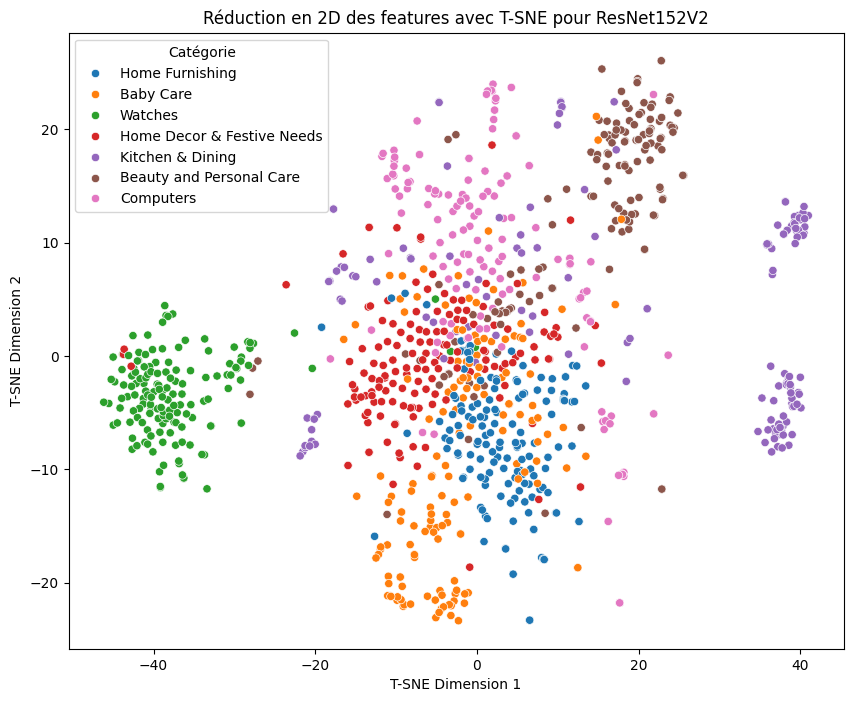

In [ ]:
# Réduction en 2 dimensions avec T-SNE
tsne = TSNE(n_components=2, random_state=42)
features_2d_resnet152v2 = tsne.fit_transform(df_resnet152v2_vectors)

# Ajout des données réduites au DataFrame
df_ResNet152V2['tsne_x'] = features_2d_resnet152v2[:, 0]
df_ResNet152V2['tsne_y'] = features_2d_resnet152v2[:, 1]

# Visualisation
plt.figure(figsize=(10, 8))
sns.scatterplot(x='tsne_x', y='tsne_y', hue='category', data=df_ResNet152V2, palette='tab10')
plt.title('Réduction en 2D des features avec T-SNE pour ResNet152V2')
plt.xlabel('T-SNE Dimension 1')
plt.ylabel('T-SNE Dimension 2')
plt.legend(title='Catégorie')
plt.show()

<ipython-input-68-adab6fb34001>:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_ResNet152V2['cluster'] = kmeans_resnet152v2.labels_


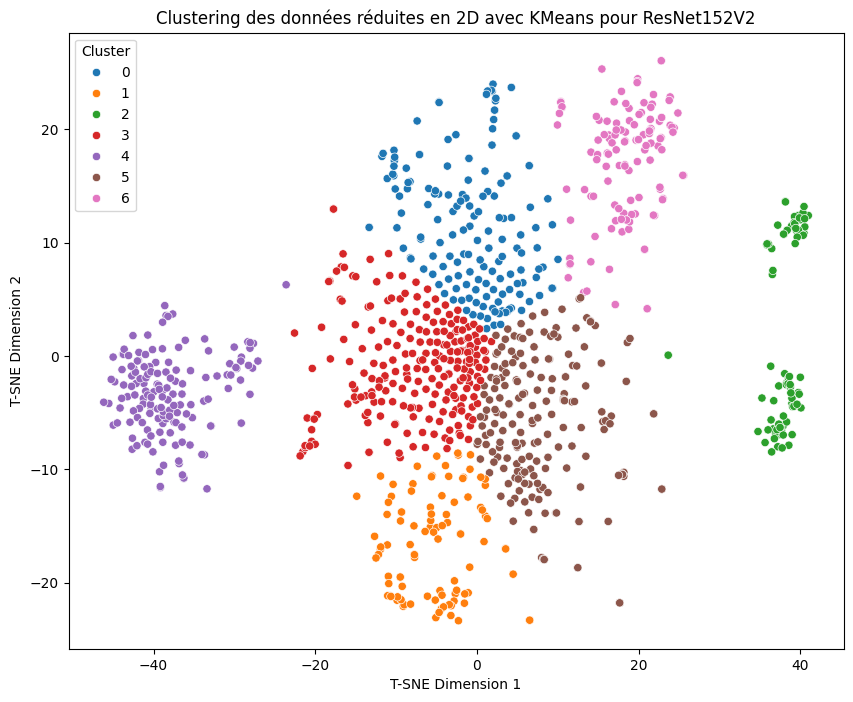

In [ ]:
# Instanciation du modèle KMeans avec initialisation normale
kmeans_resnet152v2 = KMeans(n_clusters=7, init='random', n_init=10, max_iter=200, random_state=42)

# Ajustement du modèle aux données réduites en 2 dimensions
kmeans_resnet152v2.fit(features_2d_resnet152v2)

# Ajout des étiquettes de cluster au DataFrame
df_ResNet152V2['cluster'] = kmeans_resnet152v2.labels_

# Affichage des résultats
plt.figure(figsize=(10, 8))
sns.scatterplot(x='tsne_x', y='tsne_y', hue='cluster', data=df_ResNet152V2, palette='tab10', legend='full')
plt.title('Clustering des données réduites en 2D avec KMeans pour ResNet152V2')
plt.xlabel('T-SNE Dimension 1')
plt.ylabel('T-SNE Dimension 2')
plt.legend(title='Cluster')
plt.show()

In [ ]:
# Calcul de l'indice de similarité (Adjusted Rand Score)
similarity_score = adjusted_rand_score(df_ResNet152V2['category'], df_ResNet152V2['cluster'])
print("Adjusted Rand Score:", similarity_score)

Adjusted Rand Score: 0.38486825585959517



le Modéle iInceptionV3

In [ ]:
# Utilisation de InceptionV3 pré-entraîné sur ImageNet avec les images
# d'origine
# InceptionV3 imports
from keras.applications.inception_v3 import preprocess_input
from keras.applications import InceptionV3
from keras.preprocessing import image


# Liste
incep_all_features = []

# Instanciation du modèle
model_incep = InceptionV3(weights='imagenet', include_top=False)
# Résumé de l'architecture du modèle
model_incep.summary()

for rep_image in  data_im['image_path']:

    # Charger l'image et la redimensionner à la taille
    # requise de 224×224 pixels.
    img = image.load_img(rep_image, target_size=(224, 224))
    # Convertir les pixels en un tableau NumPy afin de pouvoir travailler
    # avec dans Keras
    img = image.img_to_array(img)
    # Redimensionnement
    img = np.expand_dims(img, axis=0)
    # Préparer de nouvelles entrées pour le réseau.
    img = preprocess_input(img)

    # obtenir une prédiction de la probabilité d'appartenance
    # de l'image à chacun des 1000 types d'objets connus.
    incep_feature = model_incep.predict(img)
    # Ajouter la feature prédite en nparray à la liste
    incep_all_features.append(np.array(incep_feature).flatten())

incep_all_features = np.array(incep_all_features)

87910968/87910968 [==============================] - 1s 0us/step
Model: "inception_v3"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, None, None, 3)]      0         []                            
                                                                                                  
 conv2d (Conv2D)             (None, None, None, 32)       864       ['input_1[0][0]']             
                                                                                                  
 batch_normalization (Batch  (None, None, None, 32)       96        ['conv2d[0][0]']              
 Normalization)                                                                                   
                                                                                                  
 activation (Activatio

/usr/local/lib/python3.10/dist-packages/PIL/Image.py:3167: DecompressionBombWarning: Image size (93680328 pixels) exceeds limit of 89478485 pixels, could be decompression bomb DOS attack.
  warnings.warn(


1/1 [==============================] - 0s 141ms/step


In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.manifold import TSNE
from sklearn.cluster import KMeans
from sklearn.metrics import adjusted_rand_score
# Association des features à chaque image
data_im['features_incep'] = incep_all_features.tolist()

# Dataframe de travail
df_Incep = data_im[['image', 'image_path', 'category', 'features_incep', 'image_redim_array']]

# Constituer le dataframe de vecteurs de BOVW Inception
df_Incep_vectors = pd.DataFrame.from_records(incep_all_features)

<ipython-input-66-e038a67da3eb>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_Incep.loc[:, 'tsne_x'] = features_2d_Incep[:, 0]
<ipython-input-66-e038a67da3eb>:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_Incep.loc[:, 'tsne_y'] = features_2d_Incep[:, 1]


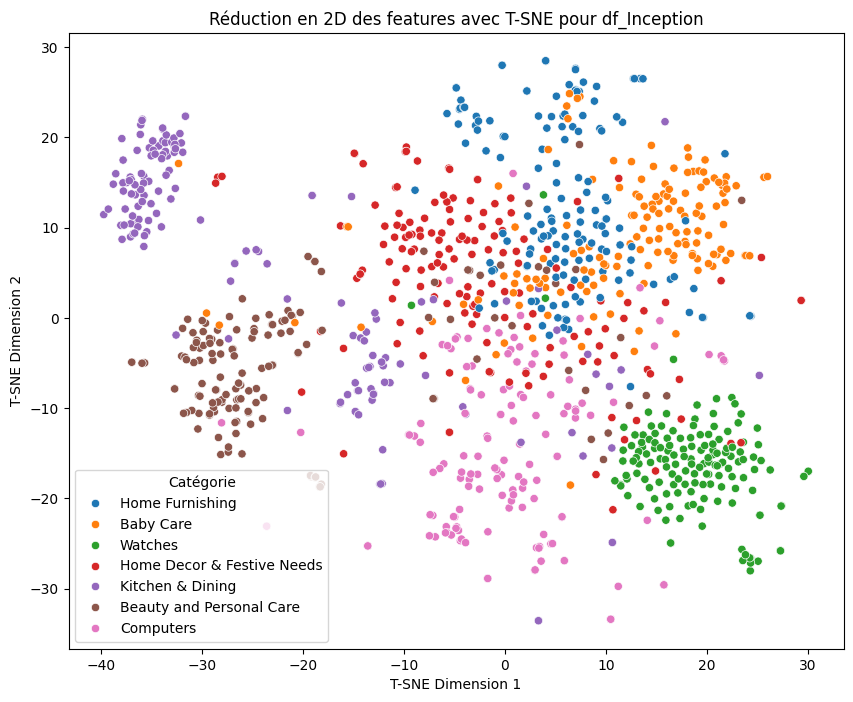

In [ ]:
# Réduction en 2 dimensions avec T-SNE
tsne = TSNE(n_components=2, random_state=42)
features_2d_Incep = tsne.fit_transform(df_Incep_vectors)

# Ajout des données réduites au DataFrame
df_Incep.loc[:, 'tsne_x'] = features_2d_Incep[:, 0]
df_Incep.loc[:, 'tsne_y'] = features_2d_Incep[:, 1]

# Visualisation
plt.figure(figsize=(10, 8))
sns.scatterplot(x='tsne_x', y='tsne_y', hue='category', data=df_Incep, palette='tab10')
plt.title('Réduction en 2D des features avec T-SNE pour df_Inception')
plt.xlabel('T-SNE Dimension 1')
plt.ylabel('T-SNE Dimension 2')
plt.legend(title='Catégorie')
plt.show()


<ipython-input-67-937fa09e8da8>:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_Incep['cluster'] = kmeans_Incep.labels_


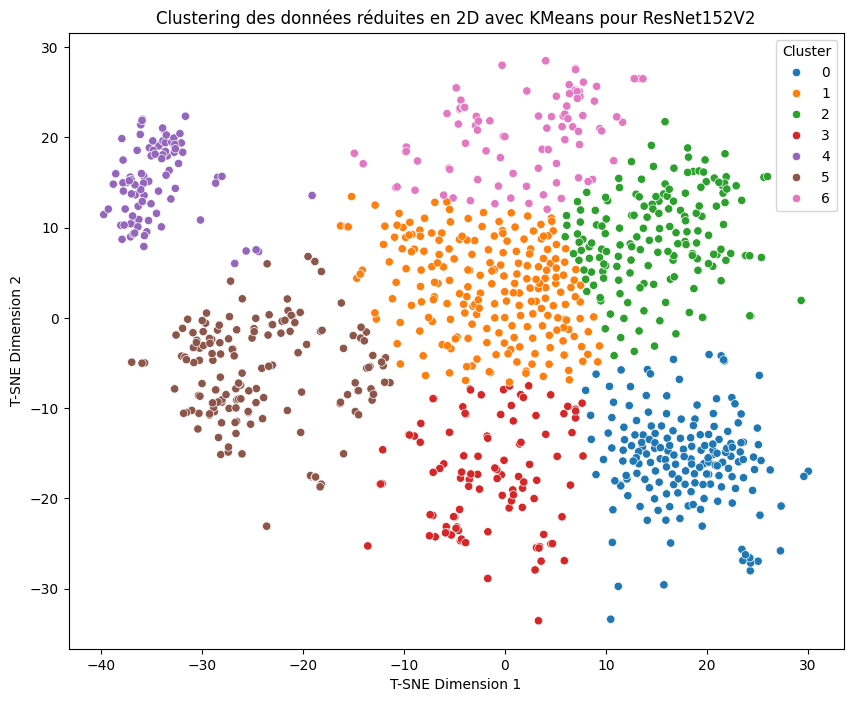

In [ ]:
# Instanciation du modèle KMeans avec initialisation normale
kmeans_Incep = KMeans(n_clusters=7, init='random', n_init=10, max_iter=200, random_state=42)

# Ajustement du modèle aux données réduites en 2 dimensions
kmeans_Incep.fit(features_2d_Incep)

# Ajout des étiquettes de cluster au DataFrame
df_Incep['cluster'] = kmeans_Incep.labels_

# Affichage des résultats
plt.figure(figsize=(10, 8))
sns.scatterplot(x='tsne_x', y='tsne_y', hue='cluster', data=df_Incep, palette='tab10', legend='full')
plt.title('Clustering des données réduites en 2D avec KMeans pour ResNet152V2')
plt.xlabel('T-SNE Dimension 1')
plt.ylabel('T-SNE Dimension 2')
plt.legend(title='Cluster')
plt.show()

In [ ]:
# Calcul de l'indice de similarité (Adjusted Rand Score)
similarity_score = adjusted_rand_score(df_Incep['category'], df_Incep['cluster'])
print("Adjusted Rand Score:", similarity_score)

Adjusted Rand Score: 0.432289072354867


le meilleur score est pour le modéle inception V3 ==> donc on va l'utiliser pour le reste de notre travail

**Notebook** 3 : classification supervisé

In [ ]:
df_Incep.head()

,image,image_path,category,features_incep,image_redim_array,tsne_x,tsne_y,cluster
0,55b85ea15a1536d46b7190ad6fff8ce7.jpg,/content/drive/MyDrive/Flipkart/Images/55b85ea...,Home Furnishing,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.3464452028274...","[[[203, 198, 189], [203, 198, 188], [203, 198,...",-2.907234,21.327421,6
1,7b72c92c2f6c40268628ec5f14c6d590.jpg,/content/drive/MyDrive/Flipkart/Images/7b72c92...,Baby Care,"[0.0, 0.0, 0.0, 0.052351996302604675, 0.0, 0.4...","[[[255, 255, 255], [255, 255, 255], [255, 255,...",5.529312,2.856274,1
2,64d5d4a258243731dc7bbb1eef49ad74.jpg,/content/drive/MyDrive/Flipkart/Images/64d5d4a...,Baby Care,"[0.0, 0.0, 0.0, 0.5097932815551758, 0.0, 0.076...","[[[255, 255, 255], [255, 255, 255], [255, 255,...",12.410804,8.205779,2
3,d4684dcdc759dd9cdf41504698d737d8.jpg,/content/drive/MyDrive/Flipkart/Images/d4684dc...,Home Furnishing,"[0.0, 0.2638792097568512, 0.0, 0.0, 0.0, 0.0, ...","[[[255, 255, 255], [255, 255, 255], [255, 255,...",4.155934,21.036247,6
4,6325b6870c54cd47be6ebfbffa620ec7.jpg,/content/drive/MyDrive/Flipkart/Images/6325b68...,Home Furnishing,"[0.10066768527030945, 0.0688476711511612, 0.96...","[[[82, 77, 71], [123, 114, 111], [155, 146, 14...",6.720372,21.183378,6


In [ ]:
df_Incep.columns

Index(['image', 'image_path', 'category', 'features_incep',
       'image_redim_array', 'tsne_x', 'tsne_y', 'cluster'],
      dtype='object')

1/ Data augmentation


In [ ]:
# Importez le module nécessaire pour la data augmentation
import imgaug.augmenters as iaa

# Définition de la séquence de transformations d'images pour la data augmentation
augmenter = iaa.Sequential([
    iaa.Affine(rotate=(-10, 10)),  # Rotation aléatoire entre -10 et 10 degrés
    iaa.Affine(translate_px={"x": (-50, 50), "y": (-50, 50)}),  # Translation aléatoire sur les deux axes
    iaa.Affine(scale={"x": (0.8, 1.2), "y": (0.8, 1.2)})  # Zoom aléatoire entre 0.8 et 1.2
])


In [ ]:
# Importer la librairie pandas si ce n'est pas déjà fait
import pandas as pd

# Afficher le type de données dans la colonne features_incep
print(type(df_Incep['features_incep'].iloc[0]))


<class 'list'>


In [ ]:
import pandas as pd
import numpy as np

# Suppose df_Incep est votre DataFrame

# Convertir les listes en tableaux NumPy dans la colonne features_incep
df_Incep.loc[:, 'features_incep'] = df_Incep['features_incep'].apply(lambda x: np.array(x) if isinstance(x, list) else x.copy())

# Définir une fonction pour ajouter du bruit à un vecteur de caractéristiques
def add_noise(features, noise_level=0.1):
    noise = np.random.normal(scale=noise_level, size=features.shape)
    noisy_features = features + noise
    return noisy_features

# Liste pour stocker les caractéristiques augmentées
augmented_features = []

# Appliquer la data augmentation à chaque vecteur de caractéristiques individuellement
for feature in df_Incep['features_incep']:
    # Appliquer la data augmentation au vecteur de caractéristiques
    augmented_feature = add_noise(feature)
    # Ajouter le vecteur de caractéristiques augmenté à la liste
    augmented_features.append(augmented_feature)

# Convertir la liste de vecteurs de caractéristiques augmentées en tableau NumPy
augmented_features = np.array(augmented_features)


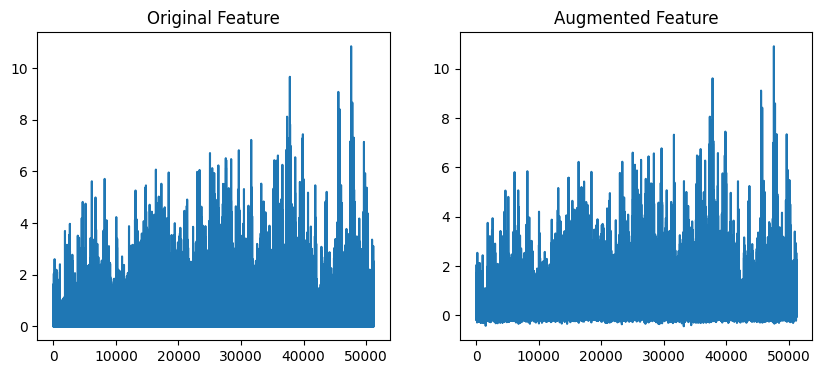

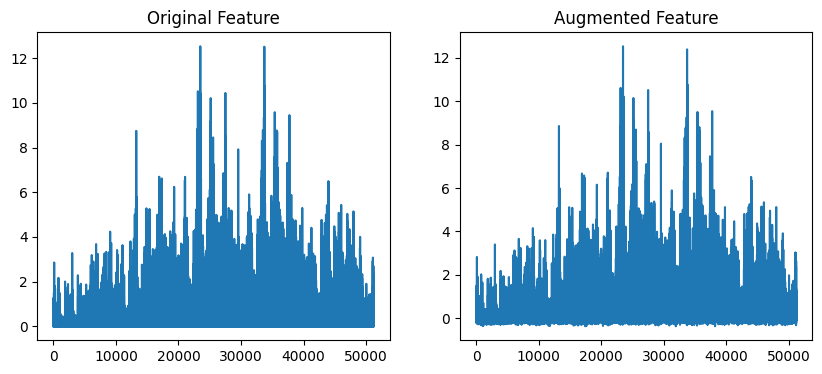

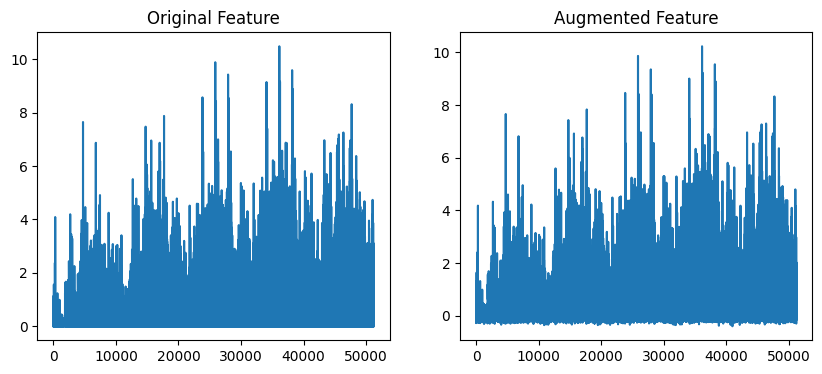

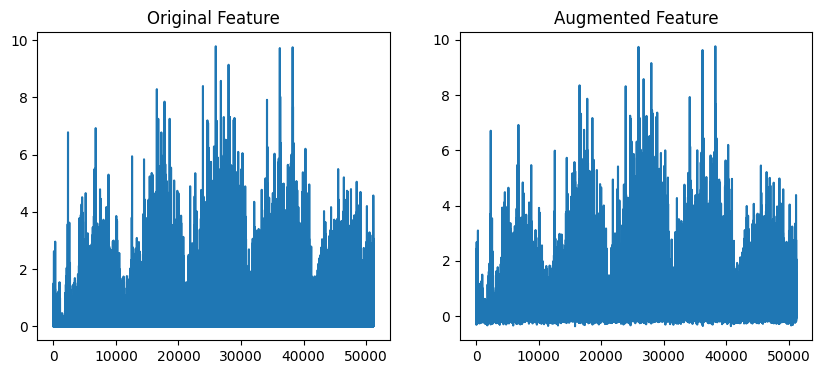

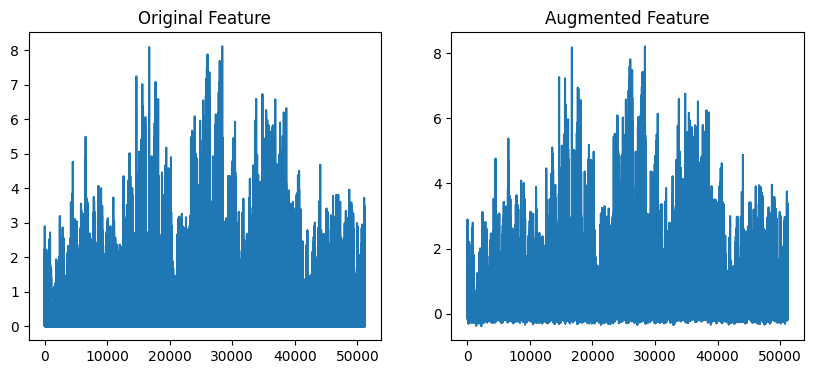

In [ ]:
import matplotlib.pyplot as plt

# Visualiser quelques exemples avant et après augmentation
num_samples = 5
original_samples = df_Incep['features_incep'][:num_samples]
augmented_samples = augmented_features[:num_samples]

for i in range(num_samples):
    plt.figure(figsize=(10, 4))
    plt.subplot(1, 2, 1)
    plt.plot(original_samples[i])
    plt.title('Original Feature')
    plt.subplot(1, 2, 2)
    plt.plot(augmented_samples[i])
    plt.title('Augmented Feature')
    plt.show()


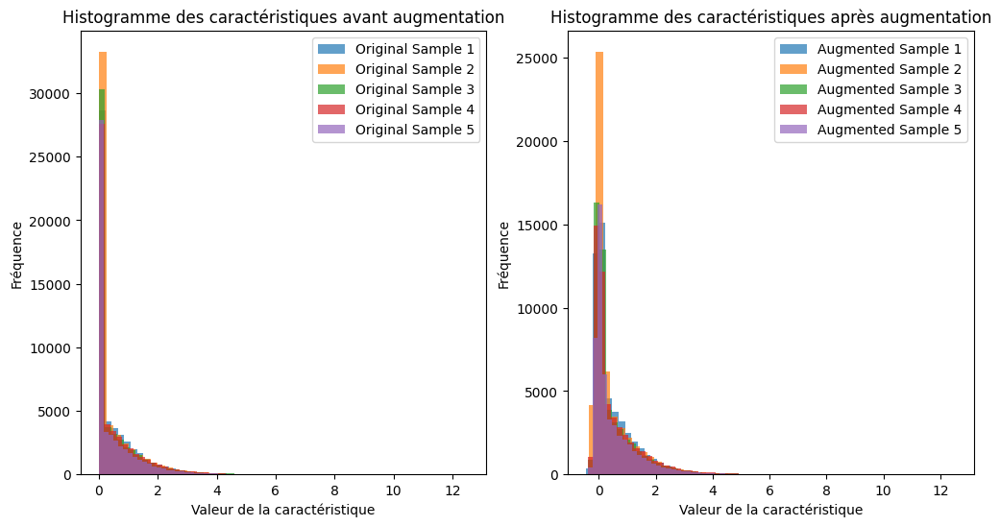

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

# Nombre d'échantillons
num_samples = 5

# Visualiser les histogrammes des caractéristiques avant et après augmentation
plt.figure(figsize=(12, 6))
plt.subplot(1, 2, 1)
for i in range(num_samples):
    plt.hist(original_samples[i], bins=50, alpha=0.7, label=f'Original Sample {i+1}')
plt.title('Histogramme des caractéristiques avant augmentation')
plt.xlabel('Valeur de la caractéristique')
plt.ylabel('Fréquence')
plt.legend()

plt.subplot(1, 2, 2)
for i in range(num_samples):
    plt.hist(augmented_samples[i], bins=50, alpha=0.7, label=f'Augmented Sample {i+1}')
plt.title('Histogramme des caractéristiques après augmentation')
plt.xlabel('Valeur de la caractéristique')
plt.ylabel('Fréquence')
plt.legend()

plt.show()


In [ ]:
df_Incep.columns

Index(['image', 'image_path', 'category', 'features_incep',
       'image_redim_array', 'tsne_x', 'tsne_y', 'cluster'],
      dtype='object')

Classification supervisé

In [ ]:
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score


labels = np.array(df_Incep['category'])

# Diviser les données augmentées en ensembles d'entraînement et de test
X_train, X_test, y_train, y_test = train_test_split(augmented_features, labels, test_size=0.2, random_state=42)

# Initialiser un modèle de régression logistique
model = LogisticRegression()

# Entraîner le modèle sur les données d'entraînement
model.fit(X_train, y_train)

# Prédire les étiquettes sur l'ensemble de test
y_pred = model.predict(X_test)

# Calculer la précision du modèle
accuracy = accuracy_score(y_test, y_pred)
print("Précision du modèle de régression logistique :", accuracy)


Précision du modèle de régression logistique : 0.8476190476190476


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


In [ ]:
from sklearn.model_selection import train_test_split
from sklearn.svm import SVC
from sklearn.metrics import accuracy_score

# Labels
labels = np.array(df_Incep['category'])

# Diviser les données augmentées en ensembles d'entraînement et de test
X_train, X_test, y_train, y_test = train_test_split(augmented_features, labels, test_size=0.2, random_state=42)

# Initialiser un modèle de SVM
model = SVC()

# Entraîner le modèle sur les données d'entraînement
model.fit(X_train, y_train)

# Prédire les étiquettes sur l'ensemble de test
y_pred = model.predict(X_test)

# Calculer la précision du modèle
accuracy = accuracy_score(y_test, y_pred)
print("Précision du modèle SVM :", accuracy)


Précision du modèle SVM : 0.8285714285714286


In [ ]:
from sklearn.model_selection import train_test_split
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import accuracy_score

# Labels
labels = np.array(df_Incep['category'])

# Diviser les données augmentées en ensembles d'entraînement et de test
X_train, X_test, y_train, y_test = train_test_split(augmented_features, labels, test_size=0.2, random_state=42)

# Initialiser un modèle d'Arbre de Décision
model = DecisionTreeClassifier()

# Entraîner le modèle sur les données d'entraînement
model.fit(X_train, y_train)

# Prédire les étiquettes sur l'ensemble de test
y_pred = model.predict(X_test)

# Calculer la précision du modèle
accuracy = accuracy_score(y_test, y_pred)
print("Précision du modèle Arbre de Décision :", accuracy)


Précision du modèle Arbre de Décision : 0.5047619047619047


In [ ]:
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score

# Labels
labels = np.array(df_Incep['category'])

# Diviser les données augmentées en ensembles d'entraînement et de test
X_train, X_test, y_train, y_test = train_test_split(augmented_features, labels, test_size=0.2, random_state=42)

# Initialiser un modèle de Random Forest
model = RandomForestClassifier()

# Entraîner le modèle sur les données d'entraînement
model.fit(X_train, y_train)

# Prédire les étiquettes sur l'ensemble de test
y_pred = model.predict(X_test)

# Calculer la précision du modèle
accuracy = accuracy_score(y_test, y_pred)
print("Précision du modèle Random Forest :", accuracy)


Précision du modèle Random Forest : 0.7571428571428571


In [ ]:
from sklearn.model_selection import train_test_split
from sklearn.ensemble import AdaBoostClassifier
from sklearn.metrics import accuracy_score

# Labels
labels = np.array(df_Incep['category'])

# Diviser les données augmentées en ensembles d'entraînement et de test
X_train, X_test, y_train, y_test = train_test_split(augmented_features, labels, test_size=0.2, random_state=42)

# Initialiser un modèle AdaBoost
model = AdaBoostClassifier()

# Entraîner le modèle sur les données d'entraînement
model.fit(X_train, y_train)

# Prédire les étiquettes sur l'ensemble de test
y_pred = model.predict(X_test)

# Calculer la précision du modèle
accuracy = accuracy_score(y_test, y_pred)
print("Précision du modèle AdaBoost :", accuracy)


Précision du modèle AdaBoost : 0.21904761904761905


Comparaison des modéles

Cross_Validation

In [ ]:
from sklearn.model_selection import cross_val_score
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier, AdaBoostClassifier

models = {
    'Logistic Regression': LogisticRegression(),
    'SVM': SVC(),
    'Decision Tree': DecisionTreeClassifier(),
    'Random Forest': RandomForestClassifier(),
    'AdaBoost': AdaBoostClassifier()
}

# Pour chaque modèle, effectuez une validation croisée avec 5 plis
for name, model in models.items():
    scores = cross_val_score(model, X_train, y_train, cv=5, scoring='accuracy')
    print(f"Précision moyenne de {name} : {scores.mean()} (+/- {scores.std() * 2})")


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _c

Précision moyenne de Logistic Regression : 0.8569646421442828 (+/- 0.032084307085245116)
Précision moyenne de SVM : 0.8295623039635014 (+/- 0.031506618257265376)
Précision moyenne de Decision Tree : 0.5078129455374965 (+/- 0.07696040460231321)
Précision moyenne de Random Forest : 0.7818434559452523 (+/- 0.049362939343287233)
Précision moyenne de AdaBoost : 0.27298973481608213 (+/- 0.08727719324193867)


Courbe De ROC_AUC pour la regression logistique


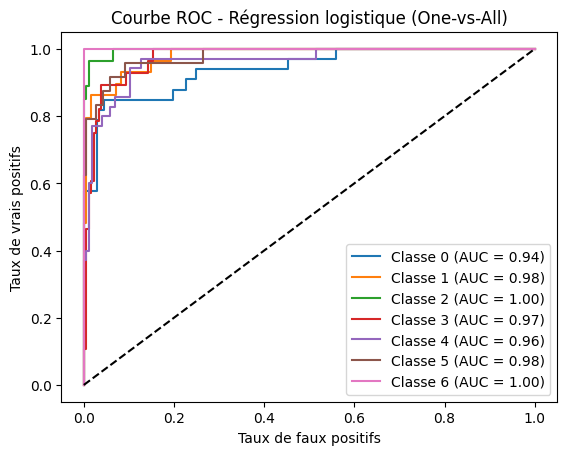

In [ ]:
from sklearn.preprocessing import label_binarize
import numpy as np

# Binariser les étiquettes
y_test_bin = label_binarize(y_test, classes=np.unique(y_test))

# Nombre de classes
n_classes = y_test_bin.shape[1]

# Calculer et tracer la courbe ROC pour chaque classe
for i in range(n_classes):
    fpr, tpr, _ = roc_curve(y_test_bin[:, i], y_prob[:, i])
    auc_score = auc(fpr, tpr)
    plt.plot(fpr, tpr, label=f"Classe {i} (AUC = {auc_score:.2f})")

plt.plot([0, 1], [0, 1], 'k--')  # Ligne en pointillés représentant la performance aléatoire
plt.xlabel('Taux de faux positifs')
plt.ylabel('Taux de vrais positifs')
plt.title('Courbe ROC - Régression logistique (One-vs-All)')
plt.legend()
plt.show()


Matrice de confusion

/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


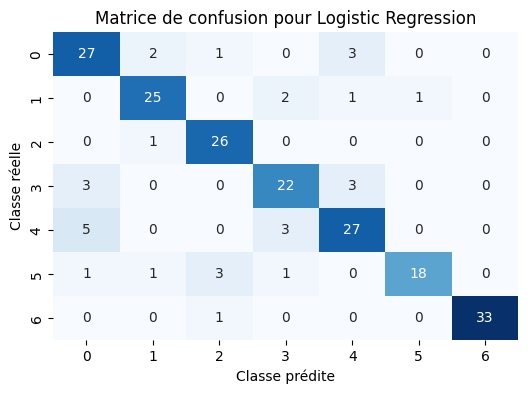

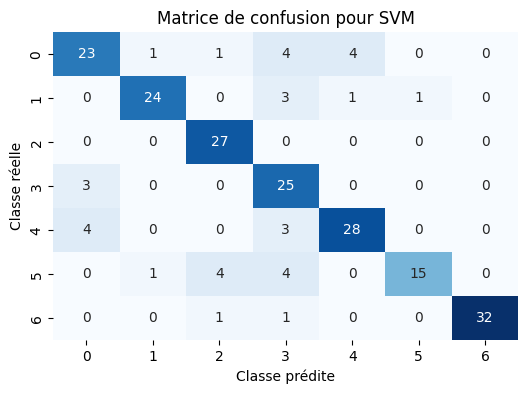

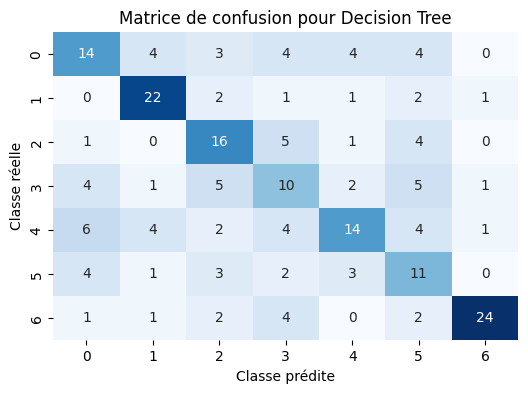

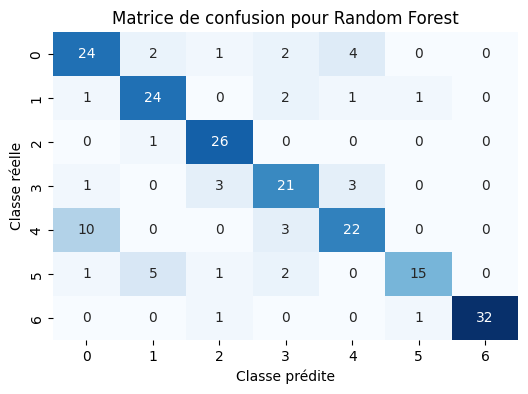

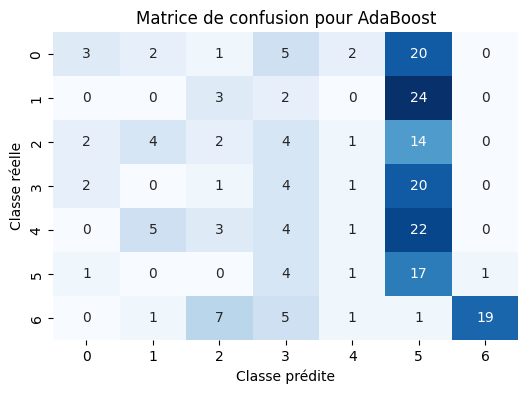

In [ ]:
from sklearn.metrics import confusion_matrix
import seaborn as sns

# Définition des modèles
models = {
    'Logistic Regression': LogisticRegression(),
    'SVM': SVC(),
    'Decision Tree': DecisionTreeClassifier(),
    'Random Forest': RandomForestClassifier(),
    'AdaBoost': AdaBoostClassifier()
}

# Affichage de la matrice de confusion pour chaque modèle
for name, model in models.items():
    model.fit(X_train, y_train)
    y_pred = model.predict(X_test)
    cm = confusion_matrix(y_test, y_pred)
    plt.figure(figsize=(6, 4))
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', cbar=False)
    plt.xlabel('Classe prédite')
    plt.ylabel('Classe réelle')
    plt.title(f'Matrice de confusion pour {name}')
    plt.show()


Effectuer Des optimaizers afin d'améliorer notre modéle de regression

In [ ]:
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score

# Initialiser un modèle de régression logistique avec l'optimiseur lbfgs
model_adam = LogisticRegression(solver='lbfgs')

# Entraîner le modèle sur les données d'entraînement existantes
model_adam.fit(X_train, y_train)

# Prédire les étiquettes sur l'ensemble de test
y_pred_adam = model_adam.predict(X_test)

# Calculer la précision du modèle
accuracy_adam = accuracy_score(y_test, y_pred_adam)
print("Précision du modèle de régression logistique avec lbfgs :", accuracy_adam)


Précision du modèle de régression logistique avec lbfgs : 0.8476190476190476


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


===> j'ai eu la méme resultat ce qui indique que notre  le modèle est capable d'apprendre efficacement à partir de nos données sans nécessiter de modifications supplémentaires.

/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


Précision du modèle de régression logistique avec 'sag' : 0.8523809523809524
Classification Report :
                            precision    recall  f1-score   support

                 Baby Care       0.75      0.82      0.78        33
  Beauty and Personal Care       0.89      0.86      0.88        29
                 Computers       0.87      0.96      0.91        27
Home Decor & Festive Needs       0.76      0.79      0.77        28
           Home Furnishing       0.80      0.80      0.80        35
          Kitchen & Dining       0.95      0.75      0.84        24
                   Watches       1.00      0.97      0.99        34

                  accuracy                           0.85       210
                 macro avg       0.86      0.85      0.85       210
              weighted avg       0.86      0.85      0.85       210



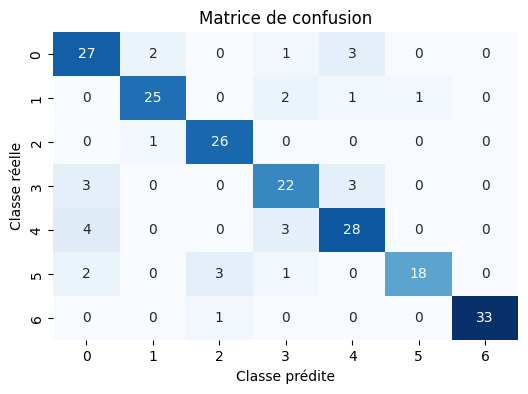

In [ ]:
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix, roc_curve, auc
import matplotlib.pyplot as plt
import seaborn as sns

# Diviser les données augmentées en ensembles d'entraînement et de test
X_train, X_test, y_train, y_test = train_test_split(augmented_features, labels, test_size=0.2, random_state=42)

# Initialiser un modèle de régression logistique avec un autre optimiseur, par exemple 'sag'
model = LogisticRegression(solver='sag')

# Entraîner le modèle sur les données d'entraînement
model.fit(X_train, y_train)

# Prédire les étiquettes sur l'ensemble de test
y_pred = model.predict(X_test)

# Calculer la précision du modèle
accuracy = accuracy_score(y_test, y_pred)
print("Précision du modèle de régression logistique avec 'sag' :", accuracy)

# Afficher le classification report
print("Classification Report :")
print(classification_report(y_test, y_pred))

# Afficher la matrice de confusion
cm = confusion_matrix(y_test, y_pred)
plt.figure(figsize=(6, 4))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', cbar=False)
plt.xlabel('Classe prédite')
plt.ylabel('Classe réelle')
plt.title('Matrice de confusion')
plt.show()


In [ ]:
print("Type de données de y_train :", type(y_train))
print("Type de données de y_test :", type(y_test))


Type de données de y_train : <class 'numpy.ndarray'>
Type de données de y_test : <class 'numpy.ndarray'>


In [ ]:
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder
import tensorflow as tf
from tensorflow.keras import Sequential
from tensorflow.keras.layers import Dense

# Convertir les étiquettes en nombres
label_encoder = LabelEncoder()
labels_encoded = label_encoder.fit_transform(df_Incep['category'])

# Diviser les données en ensembles d'entraînement et de test
X_train, X_test, y_train, y_test = train_test_split(augmented_features, labels_encoded, test_size=0.2, random_state=42)

# Définir le modèle Keras
model = Sequential([
    Dense(64, activation='relu', input_shape=(X_train.shape[1],)),
    Dense(32, activation='relu'),
    Dense(len(np.unique(labels_encoded)), activation='softmax')  # Couche de sortie avec une activation softmax pour la classification multiclasse
])

# Compiler le modèle avec l'optimiseur Adam
model.compile(optimizer='adam',
              loss='sparse_categorical_crossentropy',  # Fonction de perte pour la classification multiclasse
              metrics=['accuracy'])

# Entraîner le modèle
history = model.fit(X_train, y_train, epochs=15, batch_size=32, validation_data=(X_test, y_test))

# Évaluer le modèle sur l'ensemble de test
test_loss, test_accuracy = model.evaluate(X_test, y_test)
print("Précision du modèle sur l'ensemble de test :", test_accuracy)


Epoch 1/15


/usr/local/lib/python3.10/dist-packages/tensorflow/python/data/ops/structured_function.py:258: UserWarning: Even though the `tf.config.experimental_run_functions_eagerly` option is set, this option does not apply to tf.data functions. To force eager execution of tf.data functions, please use `tf.data.experimental.enable_debug_mode()`.
  warnings.warn(


27/27 [==============================] - 5s 165ms/step - loss: 3.5479 - accuracy: 0.4207 - val_loss: 0.9943 - val_accuracy: 0.7238
Epoch 2/15
27/27 [==============================] - 4s 164ms/step - loss: 0.6127 - accuracy: 0.8141 - val_loss: 0.9401 - val_accuracy: 0.7667
Epoch 3/15
27/27 [==============================] - 3s 123ms/step - loss: 0.2426 - accuracy: 0.9249 - val_loss: 0.7484 - val_accuracy: 0.8095
Epoch 4/15
27/27 [==============================] - 3s 95ms/step - loss: 0.1449 - accuracy: 0.9499 - val_loss: 0.7180 - val_accuracy: 0.7762
Epoch 5/15
27/27 [==============================] - 3s 105ms/step - loss: 0.0500 - accuracy: 0.9869 - val_loss: 0.6985 - val_accuracy: 0.8095
Epoch 6/15
27/27 [==============================] - 3s 95ms/step - loss: 0.0209 - accuracy: 0.9964 - val_loss: 0.6716 - val_accuracy: 0.8286
Epoch 7/15
27/27 [==============================] - 3s 121ms/step - loss: 0.0119 - accuracy: 1.0000 - val_loss: 0.6944 - val_accuracy: 0.8238
Epoch 8/15
27/27 [=

===> La précision obtenue avec ce modèle en utilisons adama optimazier est de ~82,38% après 15 epochs.
==> on remarque aussi qu'on augmentant le nombre des epochs le modéle continue a s'améliorer .

***************conslusion :

Selon les résultats, le modèle de régression logistique avec l'optimiseur 'sag' semble avoir la meilleure performance avec une précision de 85,23%